In [1]:
#<img src='images/pic1.jpg'/>

In [2]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import sqlite3
import csv
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from wordcloud import WordCloud
import re
import os
from sqlalchemy import create_engine # database connection
import datetime as dt
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.snowball import SnowballStemmer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.multiclass import OneVsRestClassifier
from sklearn.linear_model import SGDClassifier
from sklearn import metrics
from sklearn.metrics import f1_score,precision_score,recall_score
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from skmultilearn.adapt import mlknn
from skmultilearn.problem_transform import ClassifierChain
from skmultilearn.problem_transform import BinaryRelevance
from skmultilearn.problem_transform import LabelPowerset
from sklearn.naive_bayes import GaussianNB
from datetime import datetime

# Stack Overflow: Tag Prediction

<h1>1. Business Problem </h1>

<h2> 1.1 Description </h2>

<p style='font-size:18px'><b> Description </b></p>
<p>
Stack Overflow is the largest, most trusted online community for developers to learn, share their programming knowledge, and build their careers.<br />
<br />
Stack Overflow is something which every programmer use one way or another. Each month, over 50 million developers come to Stack Overflow to learn, share their knowledge, and build their careers. It features questions and answers on a wide range of topics in computer programming. The website serves as a platform for users to ask and answer questions, and, through membership and active participation, to vote questions and answers up or down and edit questions and answers in a fashion similar to a wiki or Digg. As of April 2014 Stack Overflow has over 4,000,000 registered users, and it exceeded 10,000,000 questions in late August 2015. Based on the type of tags assigned to questions, the top eight most discussed topics on the site are: Java, JavaScript, C#, PHP, Android, jQuery, Python and HTML.<br />
<br />
</p>

<p style='font-size:18px'><b> Problem Statemtent </b></p>
Suggest the tags based on the content that was there in the question posted on Stackoverflow.

<p style='font-size:18px'><b> Source:  </b> https://www.kaggle.com/c/facebook-recruiting-iii-keyword-extraction/</p>


<h2> 1.2 Source / useful links </h2>

Data Source : https://www.kaggle.com/c/facebook-recruiting-iii-keyword-extraction/data <br>
Youtube : https://youtu.be/nNDqbUhtIRg <br>
Research paper : https://www.microsoft.com/en-us/research/wp-content/uploads/2016/02/tagging-1.pdf <br>
Research paper : https://dl.acm.org/citation.cfm?id=2660970&dl=ACM&coll=DL

<h2> 1.3 Real World / Business Objectives and Constraints </h2>

1. Predict as many tags as possible with high precision and recall.
2. Incorrect tags could impact customer experience on StackOverflow.
3. No strict latency constraints.

<h1>2. Machine Learning problem </h1>

<h2> 2.1 Data </h2>

<h3> 2.1.1 Data Overview </h3>

Refer: https://www.kaggle.com/c/facebook-recruiting-iii-keyword-extraction/data
<br>
All of the data is in 2 files: Train and Test.<br />
<pre>
<b>Train.csv</b> contains 4 columns: Id,Title,Body,Tags.<br />
<b>Test.csv</b> contains the same columns but without the Tags, which you are to predict.<br />
<b>Size of Train.csv</b> - 6.75GB<br />
<b>Size of Test.csv</b> - 2GB<br />
<b>Number of rows in Train.csv</b> = 6034195<br />
</pre>
The questions are randomized and contains a mix of verbose text sites as well as sites related to math and programming. The number of questions from each site may vary, and no filtering has been performed on the questions (such as closed questions).<br />
<br />


__Data Field Explaination__

Dataset contains 6,034,195 rows. The columns in the table are:<br />
<pre>
<b>Id</b> - Unique identifier for each question<br />
<b>Title</b> - The question's title<br />
<b>Body</b> - The body of the question<br />
<b>Tags</b> - The tags associated with the question in a space-seperated format (all lowercase, should not contain tabs '\t' or ampersands '&')<br />
</pre>

<br />

<h3>2.1.2 Example Data point </h3>

<pre>
<b>Title</b>:  Implementing Boundary Value Analysis of Software Testing in a C++ program?
<b>Body </b>: <pre><code>
        #include&lt;
        iostream&gt;\n
        #include&lt;
        stdlib.h&gt;\n\n
        using namespace std;\n\n
        int main()\n
        {\n
                 int n,a[n],x,c,u[n],m[n],e[n][4];\n         
                 cout&lt;&lt;"Enter the number of variables";\n         cin&gt;&gt;n;\n\n         
                 cout&lt;&lt;"Enter the Lower, and Upper Limits of the variables";\n         
                 for(int y=1; y&lt;n+1; y++)\n         
                 {\n                 
                    cin&gt;&gt;m[y];\n                 
                    cin&gt;&gt;u[y];\n         
                 }\n         
                 for(x=1; x&lt;n+1; x++)\n         
                 {\n                 
                    a[x] = (m[x] + u[x])/2;\n         
                 }\n         
                 c=(n*4)-4;\n         
                 for(int a1=1; a1&lt;n+1; a1++)\n         
                 {\n\n             
                    e[a1][0] = m[a1];\n             
                    e[a1][1] = m[a1]+1;\n             
                    e[a1][2] = u[a1]-1;\n             
                    e[a1][3] = u[a1];\n         
                 }\n         
                 for(int i=1; i&lt;n+1; i++)\n         
                 {\n            
                    for(int l=1; l&lt;=i; l++)\n            
                    {\n                 
                        if(l!=1)\n                 
                        {\n                    
                            cout&lt;&lt;a[l]&lt;&lt;"\\t";\n                 
                        }\n            
                    }\n            
                    for(int j=0; j&lt;4; j++)\n            
                    {\n                
                        cout&lt;&lt;e[i][j];\n                
                        for(int k=0; k&lt;n-(i+1); k++)\n                
                        {\n                    
                            cout&lt;&lt;a[k]&lt;&lt;"\\t";\n               
                        }\n                
                        cout&lt;&lt;"\\n";\n            
                    }\n        
                 }    \n\n        
                 system("PAUSE");\n        
                 return 0;    \n
        }\n
        </code></pre>\n\n
        <p>The answer should come in the form of a table like</p>\n\n
        <pre><code>       
        1            50              50\n       
        2            50              50\n       
        99           50              50\n       
        100          50              50\n       
        50           1               50\n       
        50           2               50\n       
        50           99              50\n       
        50           100             50\n       
        50           50              1\n       
        50           50              2\n       
        50           50              99\n       
        50           50              100\n
        </code></pre>\n\n
        <p>if the no of inputs is 3 and their ranges are\n
        1,100\n
        1,100\n
        1,100\n
        (could be varied too)</p>\n\n
        <p>The output is not coming,can anyone correct the code or tell me what\'s wrong?</p>\n'
<b>Tags </b>: 'c++ c'
</pre>

<h2>2.2 Mapping the real-world problem to a Machine Learning Problem </h2>

<h3> 2.2.1 Type of Machine Learning Problem </h3>

<p> It is a multi-label classification problem  <br>
<b>Multi-label Classification</b>: Multilabel classification assigns to each sample a set of target labels. This can be thought as predicting properties of a data-point that are not mutually exclusive, such as topics that are relevant for a document. A question on Stackoverflow might be about any of C, Pointers, FileIO and/or memory-management at the same time or none of these. <br>
__Credit__: http://scikit-learn.org/stable/modules/multiclass.html
</p>

<h3>2.2.2 Performance metric </h3>

<b>Micro-Averaged F1-Score (Mean F Score) </b>: 
The F1 score can be interpreted as a weighted average of the precision and recall, where an F1 score reaches its best value at 1 and worst score at 0. The relative contribution of precision and recall to the F1 score are equal. The formula for the F1 score is:

<i>F1 = 2 * (precision * recall) / (precision + recall)</i><br>

In the multi-class and multi-label case, this is the weighted average of the F1 score of each class. <br>

<b>'Micro f1 score': </b><br>
Calculate metrics globally by counting the total true positives, false negatives and false positives. This is a better metric when we have class imbalance.
<br>

<b>'Macro f1 score': </b><br>
Calculate metrics for each label, and find their unweighted mean. This does not take label imbalance into account.
<br>

https://www.kaggle.com/wiki/MeanFScore <br>
http://scikit-learn.org/stable/modules/generated/sklearn.metrics.f1_score.html <br>
<br>
<b> Hamming loss </b>: The Hamming loss is the fraction of labels that are incorrectly predicted. <br>
https://www.kaggle.com/wiki/HammingLoss <br>

<h1> 3. Exploratory Data Analysis </h1>

<h2> 3.1 Data Loading and Cleaning </h2>

<h3>3.1.1 Using Pandas with SQLite to Load the data</h3>

In [3]:
#Creating db file from csv
#Learn SQL: https://www.w3schools.com/sql/default.asp
if not os.path.isfile('train.db'):
    start = datetime.now()
    disk_engine = create_engine('sqlite:///train.db')
    start = dt.datetime.now()
    chunksize = 180000
    j = 0
    index_start = 1
    for df in pd.read_csv('Train.csv', names=['Id', 'Title', 'Body', 'Tags'], chunksize=chunksize, iterator=True, encoding='utf-8', ):
        df.index += index_start
        j+=1
        print('{} rows'.format(j*chunksize))
        df.to_sql('data', disk_engine, if_exists='append')
        index_start = df.index[-1] + 1
    print("Time taken to run this cell :", datetime.now() - start)

<h3> 3.1.2 Counting the number of rows </h3>

In [4]:
if os.path.isfile('train.db'):
    start = datetime.now()
    con = sqlite3.connect('train.db')
    num_rows = pd.read_sql_query("""SELECT count(*) FROM data""", con)
    #Always remember to close the database
    print("Number of rows in the database :","\n",num_rows['count(*)'].values[0])
    con.close()
    print("Time taken to count the number of rows :", datetime.now() - start)
else:
    print("Please download the train.db file from drive or run the above cell to genarate train.db file")

Number of rows in the database : 
 6034196
Time taken to count the number of rows : 0:01:55.158083


<h3>3.1.3 Checking for duplicates </h3>

In [5]:
#Learn SQl: https://www.w3schools.com/sql/default.asp
if os.path.isfile('train.db'):
    start = datetime.now()
    con = sqlite3.connect('train.db')
    df_no_dup = pd.read_sql_query('SELECT Title, Body, Tags, COUNT(*) as cnt_dup FROM data GROUP BY Title, Body, Tags', con)
    con.close()
    print("Time taken to run this cell :", datetime.now() - start)
else:
    print("Please download the train.db file from drive or run the first to genarate train.db file")

Time taken to run this cell : 1:23:06.642288


In [6]:
df_no_dup.head()
# we can observe that there are duplicates

,Title,Body,Tags,cnt_dup
0,Implementing Boundary Value Analysis of S...,<pre><code>#include&lt;iostream&gt;\n#include&...,c++ c,1
1,Dynamic Datagrid Binding in Silverlight?,<p>I should do binding for datagrid dynamicall...,c# silverlight data-binding,1
2,Dynamic Datagrid Binding in Silverlight?,<p>I should do binding for datagrid dynamicall...,c# silverlight data-binding columns,1
3,java.lang.NoClassDefFoundError: javax/serv...,"<p>I followed the guide in <a href=""http://sta...",jsp jstl,1
4,java.sql.SQLException:[Microsoft][ODBC Dri...,<p>I use the following code</p>\n\n<pre><code>...,java jdbc,2


In [7]:
print("number of duplicate questions :", num_rows['count(*)'].values[0]- df_no_dup.shape[0], "(",(1-((df_no_dup.shape[0])/(num_rows['count(*)'].values[0])))*100,"% )")

number of duplicate questions : 1827881 ( 30.292038906260256 % )


In [8]:
# number of times each question appeared in our database
df_no_dup.cnt_dup.value_counts()

1    2656284
2    1272336
3     277575
4         90
5         25
6          5
Name: cnt_dup, dtype: int64

In [9]:
df_no_dup.head()

,Title,Body,Tags,cnt_dup
0,Implementing Boundary Value Analysis of S...,<pre><code>#include&lt;iostream&gt;\n#include&...,c++ c,1
1,Dynamic Datagrid Binding in Silverlight?,<p>I should do binding for datagrid dynamicall...,c# silverlight data-binding,1
2,Dynamic Datagrid Binding in Silverlight?,<p>I should do binding for datagrid dynamicall...,c# silverlight data-binding columns,1
3,java.lang.NoClassDefFoundError: javax/serv...,"<p>I followed the guide in <a href=""http://sta...",jsp jstl,1
4,java.sql.SQLException:[Microsoft][ODBC Dri...,<p>I use the following code</p>\n\n<pre><code>...,java jdbc,2


In [10]:
# Checking ifthere are na values in our data

df_no_dup.isnull().values.any()

# We can see that there are na values in our data

True

In [11]:
# We will now remove the na values, but first letus look at the dimensions of the data
df_no_dup.shape

(4206315, 4)

In [12]:
# We will check how many values remain after removal of na values

df_new = df_no_dup.dropna()

In [13]:
# Checking the dimensionsof the dataframe

df_new.shape

# We can see that only about 7 rows have been dropped which is really small as compared to the number of available rows
# Hence, we will drop the na values and use the 'df_no_dup' dataframe

(4206308, 4)

In [14]:
# Removing all the na values and creating our final dataframe without duplicates and na values
df_no_dup = df_no_dup.dropna()

In [15]:
# Counting the number of tags per question
start = datetime.now()

df_no_dup["tag_count"] = df_no_dup["Tags"].apply(lambda text: len(text.split(" ")))
# adding a new feature number of tags per question
print("Time taken to run this cell :", datetime.now() - start)
df_no_dup.head()

Time taken to run this cell : 0:00:08.384246


,Title,Body,Tags,cnt_dup,tag_count
0,Implementing Boundary Value Analysis of S...,<pre><code>#include&lt;iostream&gt;\n#include&...,c++ c,1,2
1,Dynamic Datagrid Binding in Silverlight?,<p>I should do binding for datagrid dynamicall...,c# silverlight data-binding,1,3
2,Dynamic Datagrid Binding in Silverlight?,<p>I should do binding for datagrid dynamicall...,c# silverlight data-binding columns,1,4
3,java.lang.NoClassDefFoundError: javax/serv...,"<p>I followed the guide in <a href=""http://sta...",jsp jstl,1,2
4,java.sql.SQLException:[Microsoft][ODBC Dri...,<p>I use the following code</p>\n\n<pre><code>...,java jdbc,2,2


In [16]:
# distribution of number of tags per question
df_no_dup.tag_count.value_counts()

3    1206157
2    1111706
4     814996
1     568291
5     505158
Name: tag_count, dtype: int64

In [17]:
#Creating a new database with no duplicates
if not os.path.isfile('train_no_dup.db'):
    disk_dup = create_engine("sqlite:///train_no_dup.db")
    no_dup = pd.DataFrame(df_no_dup, columns=['Title', 'Body', 'Tags'])
    no_dup.to_sql('no_dup_train',disk_dup)

In [18]:
#This method seems more appropriate to work with this much data.
#creating the connection with database file.
if os.path.isfile('train_no_dup.db'):
    start = datetime.now()
    con = sqlite3.connect('train_no_dup.db')
    tag_data = pd.read_sql_query("""SELECT Tags FROM no_dup_train""", con)
    #Always remember to close the database
    con.close()

    # Let's now drop unwanted column.
    tag_data.drop(tag_data.index[0], inplace=True)
    #Printing first 5 columns from our data frame
    tag_data.head()
    print("Time taken to run this cell :", datetime.now() - start)
else:
    print("Please download the train.db file from drive or run the above cells to genarate train.db file")

Time taken to run this cell : 0:03:53.993603


In [19]:
# Checking for na values in 
tag_data.isnull().values.any()

True

In [20]:
# Checking the dimensions of the tag_data

tag_data.shape

(4206314, 1)

In [21]:
# Checking how many rows will remain if we remove the na values

tag_data_new = tag_data.dropna()

In [22]:
# Checking the shape of the data with removed values

tag_data_new.shape

# We can see that 7 values are removed, which is ok.

(4206307, 1)

In [23]:
# We will remove the na values from the data and create a final dataframe

tag_data = tag_data.dropna()

<h2> 3.2 Analysis of Tags </h2>

<h3> 3.2.1 Total number of unique tags </h3>

In [24]:
# Importing & Initializing the "CountVectorizer" object, which 
#is scikit-learn's bag of words tool.

#by default 'split()' will tokenize each tag using space.
vectorizer = CountVectorizer(tokenizer = lambda x: x.split())
# fit_transform() does two functions: First, it fits the model
# and learns the vocabulary; second, it transforms our training data
# into feature vectors. The input to fit_transform should be a list of strings.
tag_dtm = vectorizer.fit_transform(tag_data['Tags'])

In [25]:
print("Number of data points :", tag_dtm.shape[0])
print("Number of unique tags :", tag_dtm.shape[1])

Number of data points : 4206307
Number of unique tags : 42048


In [26]:
#'get_feature_name()' gives us the vocabulary.
tags = vectorizer.get_feature_names()
#Lets look at the tags we have.
print("Some of the tags we have :", tags[:10])

Some of the tags we have : ['.a', '.app', '.asp.net-mvc', '.aspxauth', '.bash-profile', '.class-file', '.cs-file', '.doc', '.drv', '.ds-store']


<h3> 3.2.3 Number of times a tag appeared </h3>

In [27]:
# https://stackoverflow.com/questions/15115765/how-to-access-sparse-matrix-elements
#Lets now store the document term matrix in a dictionary.
freqs = tag_dtm.sum(axis=0).A1
result = dict(zip(tags, freqs))

In [28]:
#Saving this dictionary to csv files.
if not os.path.isfile('tag_counts_dict_dtm.csv'):
    with open('tag_counts_dict_dtm.csv', 'w') as csv_file:
        writer = csv.writer(csv_file)
        for key, value in result.items():
            writer.writerow([key, value])
tag_df = pd.read_csv("tag_counts_dict_dtm.csv", names=['Tags', 'Counts'])
tag_df.head()

,Tags,Counts
0,.a,18
1,.app,37
2,.asp.net-mvc,1
3,.aspxauth,21
4,.bash-profile,138


In [29]:
tag_df_sorted = tag_df.sort_values(['Counts'], ascending=False)
tag_counts = tag_df_sorted['Counts'].values

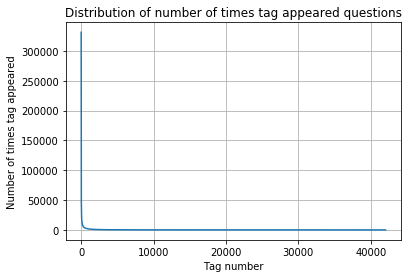

In [30]:
plt.plot(tag_counts)
plt.title("Distribution of number of times tag appeared questions")
plt.grid()
plt.xlabel("Tag number")
plt.ylabel("Number of times tag appeared")
plt.show()

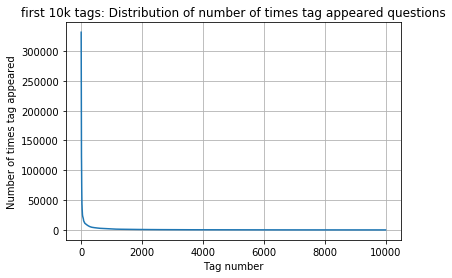

400 [331505  44829  22429  17728  13364  11162  10029   9148   8054   7151
   6466   5865   5370   4983   4526   4281   4144   3929   3750   3593
   3453   3299   3123   2986   2891   2738   2647   2527   2431   2331
   2259   2186   2097   2020   1959   1900   1828   1770   1723   1673
   1631   1574   1532   1479   1448   1406   1365   1328   1300   1266
   1245   1222   1197   1181   1158   1139   1121   1101   1076   1056
   1038   1023   1006    983    966    952    938    926    911    891
    882    869    856    841    830    816    804    789    779    770
    752    743    733    725    712    702    688    678    671    658
    650    643    634    627    616    607    598    589    583    577
    568    559    552    545    540    533    526    518    512    506
    500    495    490    485    480    477    469    465    457    450
    447    442    437    432    426    422    418    413    408    403
    398    393    388    385    381    378    374    370    367    365
  

In [31]:
plt.plot(tag_counts[0:10000])
plt.title('first 10k tags: Distribution of number of times tag appeared questions')
plt.grid()
plt.xlabel("Tag number")
plt.ylabel("Number of times tag appeared")
plt.show()
print(len(tag_counts[0:10000:25]), tag_counts[0:10000:25])

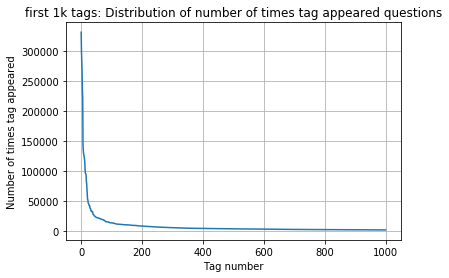

200 [331505 221533 122769  95160  62023  44829  37170  31897  26925  24537
  22429  21820  20957  19758  18905  17728  15533  15097  14884  13703
  13364  13157  12407  11658  11228  11162  10863  10600  10350  10224
  10029   9884   9719   9411   9252   9148   9040   8617   8361   8163
   8054   7867   7702   7564   7274   7151   7052   6847   6656   6553
   6466   6291   6183   6093   5971   5865   5760   5577   5490   5411
   5370   5283   5207   5107   5066   4983   4891   4785   4658   4549
   4526   4487   4429   4335   4310   4281   4239   4228   4195   4159
   4144   4088   4050   4002   3957   3929   3874   3849   3818   3797
   3750   3703   3685   3658   3615   3593   3564   3521   3505   3483
   3453   3427   3396   3363   3326   3299   3272   3232   3196   3168
   3123   3094   3073   3050   3012   2986   2983   2953   2934   2903
   2891   2844   2819   2784   2754   2738   2726   2708   2681   2669
   2647   2621   2604   2594   2556   2527   2510   2482   2460   2444
  

In [32]:
plt.plot(tag_counts[0:1000])
plt.title('first 1k tags: Distribution of number of times tag appeared questions')
plt.grid()
plt.xlabel("Tag number")
plt.ylabel("Number of times tag appeared")
plt.show()
print(len(tag_counts[0:1000:5]), tag_counts[0:1000:5])

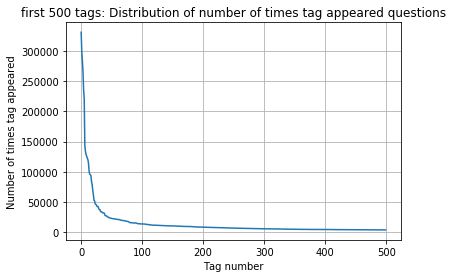

100 [331505 221533 122769  95160  62023  44829  37170  31897  26925  24537
  22429  21820  20957  19758  18905  17728  15533  15097  14884  13703
  13364  13157  12407  11658  11228  11162  10863  10600  10350  10224
  10029   9884   9719   9411   9252   9148   9040   8617   8361   8163
   8054   7867   7702   7564   7274   7151   7052   6847   6656   6553
   6466   6291   6183   6093   5971   5865   5760   5577   5490   5411
   5370   5283   5207   5107   5066   4983   4891   4785   4658   4549
   4526   4487   4429   4335   4310   4281   4239   4228   4195   4159
   4144   4088   4050   4002   3957   3929   3874   3849   3818   3797
   3750   3703   3685   3658   3615   3593   3564   3521   3505   3483]


In [33]:
plt.plot(tag_counts[0:500])
plt.title('first 500 tags: Distribution of number of times tag appeared questions')
plt.grid()
plt.xlabel("Tag number")
plt.ylabel("Number of times tag appeared")
plt.show()
print(len(tag_counts[0:500:5]), tag_counts[0:500:5])

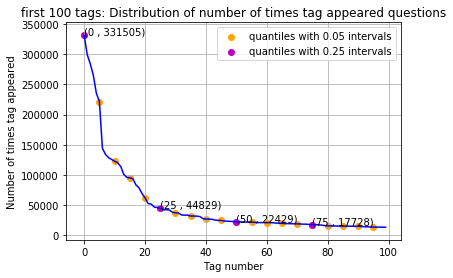

20 [331505 221533 122769  95160  62023  44829  37170  31897  26925  24537
  22429  21820  20957  19758  18905  17728  15533  15097  14884  13703]


In [34]:
plt.plot(tag_counts[0:100], c='b')
plt.scatter(x=list(range(0,100,5)), y=tag_counts[0:100:5], c='orange', label="quantiles with 0.05 intervals")
# quantiles with 0.25 difference
plt.scatter(x=list(range(0,100,25)), y=tag_counts[0:100:25], c='m', label = "quantiles with 0.25 intervals")

for x,y in zip(list(range(0,100,25)), tag_counts[0:100:25]):
    plt.annotate(s="({} , {})".format(x,y), xy=(x,y), xytext=(x-0.05, y+500))

plt.title('first 100 tags: Distribution of number of times tag appeared questions')
plt.grid()
plt.xlabel("Tag number")
plt.ylabel("Number of times tag appeared")
plt.legend()
plt.show()
print(len(tag_counts[0:100:5]), tag_counts[0:100:5])

In [35]:
# Store tags greater than 10K in one list
lst_tags_gt_10k = tag_df[tag_df.Counts>10000].Tags
#Print the length of the list
print ('{} Tags are used more than 10000 times'.format(len(lst_tags_gt_10k)))
# Store tags greater than 100K in one list
lst_tags_gt_100k = tag_df[tag_df.Counts>100000].Tags
#Print the length of the list.
print ('{} Tags are used more than 100000 times'.format(len(lst_tags_gt_100k)))

153 Tags are used more than 10000 times
14 Tags are used more than 100000 times


<b>Observations:</b><br />
1. There are total 153 tags which are used more than 10000 times.
2. 14 tags are used more than 100000 times.
3. Most frequent tag (i.e. c#) is used 331505 times.
4. Since some tags occur much more frequenctly than others, Micro-averaged F1-score is the appropriate metric for this probelm.

<h3> 3.2.4 Tags Per Question </h3>

In [36]:
#Storing the count of tag in each question in list 'tag_count'
tag_quest_count = tag_dtm.sum(axis=1).tolist()
#Converting each value in the 'tag_quest_count' to integer.
tag_quest_count=[int(j) for i in tag_quest_count for j in i]
print ('We have total {} datapoints.'.format(len(tag_quest_count)))

print(tag_quest_count[:5])

We have total 4206307 datapoints.
[3, 4, 2, 2, 3]


In [37]:
print( "Maximum number of tags per question: %d"%max(tag_quest_count))
print( "Minimum number of tags per question: %d"%min(tag_quest_count))
print( "Avg. number of tags per question: %f"% ((sum(tag_quest_count)*1.0)/len(tag_quest_count)))

Maximum number of tags per question: 5
Minimum number of tags per question: 1
Avg. number of tags per question: 2.899443


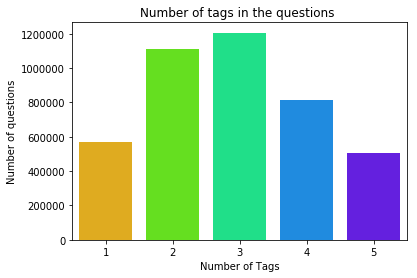

In [38]:
sns.countplot(tag_quest_count, palette='gist_rainbow')
plt.title("Number of tags in the questions ")
plt.xlabel("Number of Tags")
plt.ylabel("Number of questions")
plt.show()

<b>Observations:</b><br />
1. Maximum number of tags per question: 5
2. Minimum number of tags per question: 1
3. Avg. number of tags per question: 2.899
4. Most of the questions are having 2 or 3 tags

<h3>3.2.5 Most Frequent Tags </h3>

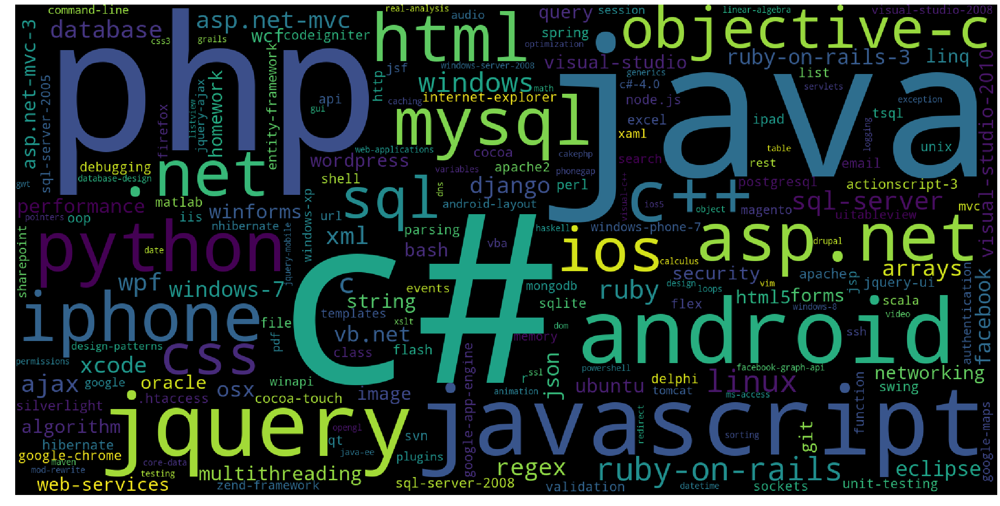

Time taken to run this cell : 0:00:26.270700


In [39]:
# Ploting word cloud
start = datetime.now()

# Lets first convert the 'result' dictionary to 'list of tuples'
tup = dict(result.items())
#Initializing WordCloud using frequencies of tags.
wordcloud = WordCloud(    background_color='black',
                          width=1600,
                          height=800,
                    ).generate_from_frequencies(tup)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
fig.savefig("tag.png")
plt.show()
print("Time taken to run this cell :", datetime.now() - start)

<b>Observations:</b><br />
A look at the word cloud shows that "c#", "java", "php", "asp.net", "javascript", "c++" are some of the most frequent tags.

<h3> 3.2.6 The top 20 tags </h3>

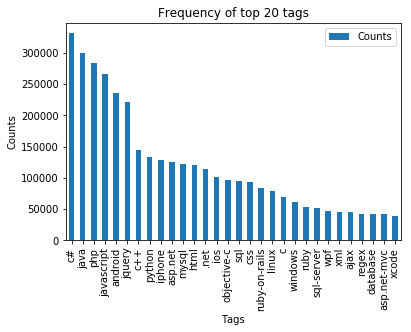

In [40]:
i=np.arange(30)
tag_df_sorted.head(30).plot(kind='bar')
plt.title('Frequency of top 20 tags')
plt.xticks(i, tag_df_sorted['Tags'])
plt.xlabel('Tags')
plt.ylabel('Counts')
plt.show()

<b>Observations:</b><br />
1. Majority of the most frequent tags are programming language.
2. C# is the top most frequent programming language.
3. Android, IOS, Linux and windows are among the top most frequent operating systems.

<h3> 3.3 Cleaning and preprocessing of Questions </h3>

In [41]:
def striphtml(data):
    cleanr = re.compile('<.*?>')
    cleantext = re.sub(cleanr, ' ', str(data))
    return cleantext
stop_words = set(stopwords.words('english'))
stemmer = SnowballStemmer("english")

In [42]:
#http://www.sqlitetutorial.net/sqlite-python/create-tables/
def create_connection(db_file):
    """ create a database connection to the SQLite database
        specified by db_file
    :param db_file: database file
    :return: Connection object or None
    """
    try:
        conn = sqlite3.connect(db_file)
        return conn
    except Error as e:
        print(e)
 
    return None

def create_table(conn, create_table_sql):
    """ create a table from the create_table_sql statement
    :param conn: Connection object
    :param create_table_sql: a CREATE TABLE statement
    :return:
    """
    try:
        c = conn.cursor()
        c.execute(create_table_sql)
    except Error as e:
        print(e)
        
def checkTableExists(dbcon):
    cursr = dbcon.cursor()
    str = "select name from sqlite_master where type='table'"
    table_names = cursr.execute(str)
    print("Tables in the databse:")
    tables =table_names.fetchall() 
    print(tables[0][0])
    return(len(tables))

def create_database_table(database, query):
    conn = create_connection(database)
    if conn is not None:
        create_table(conn, query)
        checkTableExists(conn)
    else:
        print("Error! cannot create the database connection.")
    conn.close()

sql_create_table = """CREATE TABLE IF NOT EXISTS QuestionsProcessed (question text NOT NULL, code text, tags text, words_pre integer, words_post integer, is_code integer);"""
create_database_table("Processed.db", sql_create_table)

Tables in the databse:
QuestionsProcessed


In [43]:

def tags_to_choose(n):
    t = multilabel_y.sum(axis=0).tolist()[0]
    sorted_tags_i = sorted(range(len(t)), key=lambda i: t[i], reverse=True)
    multilabel_yn=multilabel_y[:,sorted_tags_i[:n]]
    return multilabel_yn

def questions_explained_fn(n):
    multilabel_yn = tags_to_choose(n)
    x= multilabel_yn.sum(axis=1)
    return (np.count_nonzero(x==0))

In [44]:
sql_create_table = """CREATE TABLE IF NOT EXISTS QuestionsProcessed (question text NOT NULL, code text, tags text, words_pre integer, words_post integer, is_code integer);"""
create_database_table("Titlemoreweight.db", sql_create_table)

Tables in the databse:
QuestionsProcessed


In [45]:

# http://www.sqlitetutorial.net/sqlite-delete/
# https://stackoverflow.com/questions/2279706/select-random-row-from-a-sqlite-table
start = datetime.now()
read_db = 'train_no_dup.db'
write_db = 'Titlemoreweight.db'
train_datasize = 400000
if os.path.isfile(read_db):
    conn_r = create_connection(read_db)
    if conn_r is not None:
        reader =conn_r.cursor()
        # for selecting first 0.5M rows
        reader.execute("SELECT Title, Body, Tags From no_dup_train LIMIT 500001;")
        # for selecting random points
        #reader.execute("SELECT Title, Body, Tags From no_dup_train ORDER BY RANDOM() LIMIT 500001;")

if os.path.isfile(write_db):
    conn_w = create_connection(write_db)
    if conn_w is not None:
        tables = checkTableExists(conn_w)
        writer =conn_w.cursor()
        if tables != 0:
            writer.execute("DELETE FROM QuestionsProcessed WHERE 1")
            print("Cleared All the rows")

print("Time taken to run this cell :", datetime.now() - start)

Tables in the databse:
QuestionsProcessed
Cleared All the rows
Time taken to run this cell : 0:01:54.673531


<h3> 4.5.1 Preprocessing of questions </h3>

In [46]:
#http://www.bernzilla.com/2008/05/13/selecting-a-random-row-from-an-sqlite-table/
start = datetime.now()
preprocessed_data_list=[]
reader.fetchone()
questions_with_code=0
len_pre=0
len_post=0
questions_proccesed = 0
for row in reader:
    
    is_code = 0
    
    title, question, tags = row[0], row[1], str(row[2])
    
    if '<code>' in question:
        questions_with_code+=1
        is_code = 1
    x = len(question)+len(title)
    len_pre+=x
    
    code = str(re.findall(r'<code>(.*?)</code>', question, flags=re.DOTALL))
    
    question=re.sub('<code>(.*?)</code>', '', question, flags=re.MULTILINE|re.DOTALL)
    question=striphtml(question.encode('utf-8'))
    
    title=title.encode('utf-8')
    
    # adding title three time to the data to increase its weight
    # add tags string to the training data
    
    question=str(title)+" "+str(title)+" "+str(title)+" "+question
    
#     if questions_proccesed<=train_datasize:
#         question=str(title)+" "+str(title)+" "+str(title)+" "+question+" "+str(tags)
#     else:
#         question=str(title)+" "+str(title)+" "+str(title)+" "+question

    question=re.sub(r'[^A-Za-z0-9#+.\-]+',' ',question)
    words=word_tokenize(str(question.lower()))
    
    #Removing all single letter and and stopwords from question exceptt for the letter 'c'
    question=' '.join(str(stemmer.stem(j)) for j in words if j not in stop_words and (len(j)!=1 or j=='c'))
    
    len_post+=len(question)
    tup = (question,code,tags,x,len(question),is_code)
    questions_proccesed += 1
    writer.execute("insert into QuestionsProcessed(question,code,tags,words_pre,words_post,is_code) values (?,?,?,?,?,?)",tup)
    if (questions_proccesed%100000==0):
        print("number of questions completed=",questions_proccesed)

no_dup_avg_len_pre=(len_pre*1.0)/questions_proccesed
no_dup_avg_len_post=(len_post*1.0)/questions_proccesed

print( "Avg. length of questions(Title+Body) before processing: %d"%no_dup_avg_len_pre)
print( "Avg. length of questions(Title+Body) after processing: %d"%no_dup_avg_len_post)
print ("Percent of questions containing code: %d"%((questions_with_code*100.0)/questions_proccesed))

print("Time taken to run this cell :", datetime.now() - start)

number of questions completed= 100000
number of questions completed= 200000
number of questions completed= 300000
number of questions completed= 400000
number of questions completed= 500000
Avg. length of questions(Title+Body) before processing: 1239
Avg. length of questions(Title+Body) after processing: 424
Percent of questions containing code: 57
Time taken to run this cell : 0:25:53.862987


In [47]:
# never forget to close the conections or else we will end up with database locks
conn_r.commit()
conn_w.commit()
conn_r.close()
conn_w.close()

__ Sample quesitons after preprocessing of data __

In [48]:
if os.path.isfile(write_db):
    conn_r = create_connection(write_db)
    if conn_r is not None:
        reader =conn_r.cursor()
        reader.execute("SELECT question From QuestionsProcessed LIMIT 10")
        print("Questions after preprocessed")
        print('='*100)
        reader.fetchone()
        for row in reader:
            print(row)
            print('-'*100)
conn_r.commit()
conn_r.close()

Questions after preprocessed
('dynam datagrid bind silverlight dynam datagrid bind silverlight dynam datagrid bind silverlight bind datagrid dynam code wrote code debug code block seem bind correct grid come column form come grid column although necessari bind nthank repli advance..',)
----------------------------------------------------------------------------------------------------
('java.lang.noclassdeffounderror javax servlet jsp tagext taglibraryvalid java.lang.noclassdeffounderror javax servlet jsp tagext taglibraryvalid java.lang.noclassdeffounderror javax servlet jsp tagext taglibraryvalid follow guid link instal jstl got follow error tri launch jsp page java.lang.noclassdeffounderror javax servlet jsp tagext taglibraryvalid taglib declar instal jstl 1.1 tomcat webapp tri project work also tri version 1.2 jstl still messag caus solv',)
----------------------------------------------------------------------------------------------------
('java.sql.sqlexcept microsoft odbc driver

__ Saving Preprocessed data to a Database __

In [49]:
#Taking 0.5 Million entries to a dataframe.
write_db = 'Titlemoreweight.db'
if os.path.isfile(write_db):
    conn_r = create_connection(write_db)
    if conn_r is not None:
        preprocessed_data = pd.read_sql_query("""SELECT question, Tags FROM QuestionsProcessed""", conn_r)
conn_r.commit()
conn_r.close()

In [50]:
preprocessed_data.head()

,question,tags
0,dynam datagrid bind silverlight dynam datagrid...,c# silverlight data-binding
1,dynam datagrid bind silverlight dynam datagrid...,c# silverlight data-binding columns
2,java.lang.noclassdeffounderror javax servlet j...,jsp jstl
3,java.sql.sqlexcept microsoft odbc driver manag...,java jdbc
4,better way updat feed fb php sdk better way up...,facebook api facebook-php-sdk


In [79]:
#print(preprocessed_data.tags.apply(lambda x: pd.Series(str(x).split(" "))))

                       0                  1                      2  \
0                     c#        silverlight           data-binding   
1                     c#        silverlight           data-binding   
2                    jsp               jstl                    NaN   
3                   java               jdbc                    NaN   
4               facebook                api       facebook-php-sdk   
5             javascript            asp.net                    web   
6                    php              forms                    NaN   
7          real-analysis     measure-theory                    NaN   
8              hibernate                hql                    NaN   
9                 iphone  email-integration                    NaN   
10                  java           servlets                  jboss   
11               android     android-widget        android-service   
12                    c#               .net        rijndaelmanaged   
13            javasc

In [80]:
preprocessed_data_final = preprocessed_data

In [81]:
preprocessed_data_final.head(3)

,question,tags
0,dynam datagrid bind silverlight dynam datagrid...,c# silverlight data-binding
1,dynam datagrid bind silverlight dynam datagrid...,c# silverlight data-binding columns
2,java.lang.noclassdeffounderror javax servlet j...,jsp jstl


In [82]:
preprocessed_data_final[['t1','t2','t3','t4','t5']] = preprocessed_data.tags.apply(lambda x: pd.Series(str(x).split(" ")))

In [83]:
preprocessed_data_final.head(5)

,question,tags,t1,t2,t3,t4,t5
0,dynam datagrid bind silverlight dynam datagrid...,c# silverlight data-binding,c#,silverlight,data-binding,NaN,NaN
1,dynam datagrid bind silverlight dynam datagrid...,c# silverlight data-binding columns,c#,silverlight,data-binding,columns,NaN
2,java.lang.noclassdeffounderror javax servlet j...,jsp jstl,jsp,jstl,NaN,NaN,NaN
3,java.sql.sqlexcept microsoft odbc driver manag...,java jdbc,java,jdbc,NaN,NaN,NaN
4,better way updat feed fb php sdk better way up...,facebook api facebook-php-sdk,facebook,api,facebook-php-sdk,NaN,NaN


## We will explore the data more i.e plot the wordcloud for the question based on the top 20 tags to check the most frequently occuring words for that particular tag


### Extracting questions with 'c#' and related tags

In [84]:
df_csharpe = preprocessed_data_final[(preprocessed_data_final['t1'] == 'c#') | (preprocessed_data_final['t2'] == 'c#') |
                                     (preprocessed_data_final['t3'] == 'c#') | (preprocessed_data_final['t4'] == 'c#') |
                                     (preprocessed_data_final['t5'] == 'c#')]

In [87]:
df_csharpefinal = df_csharpe[['question']]

### Extracting questions with 'java' and related tags

In [89]:
df_java = preprocessed_data_final[(preprocessed_data_final['t1'] == 'java') | (preprocessed_data_final['t2'] == 'java') |
                                  (preprocessed_data_final['t3'] == 'java') | (preprocessed_data_final['t4'] == 'java') |
                                  (preprocessed_data_final['t5'] == 'java')]
df_javafinal = df_java[['question']]

### Extracting questions with 'php' and related tags

In [91]:
df_php = preprocessed_data_final[(preprocessed_data_final['t1'] == 'php') | (preprocessed_data_final['t2'] == 'php') |
                                 (preprocessed_data_final['t3'] == 'php') | (preprocessed_data_final['t4'] == 'php') |
                                 (preprocessed_data_final['t5'] == 'php')]
df_phpfinal = df_php[['question']]

### Extracting questions with 'javascript' and related tags

In [92]:
df_javascript = preprocessed_data_final[(preprocessed_data_final['t1'] == 'javascript') | (preprocessed_data_final['t2'] == 'javascript') |
                                        (preprocessed_data_final['t3'] == 'javascript') | (preprocessed_data_final['t4'] == 'javascript') |
                                        (preprocessed_data_final['t5'] == 'javascript')]
df_javascriptfinal = df_javascript[['question']]

### Extracting questions with 'android' and related tags

In [93]:
df_android = preprocessed_data_final[(preprocessed_data_final['t1'] == 'android') | (preprocessed_data_final['t2'] == 'android') |
                                     (preprocessed_data_final['t3'] == 'android') | (preprocessed_data_final['t4'] == 'android') |
                                     (preprocessed_data_final['t5'] == 'android')]
df_androidfinal = df_android[['question']]

### Extracting questions with 'jquery' and related tags

In [94]:
df_jquery = preprocessed_data_final[(preprocessed_data_final['t1'] == 'jquery') | (preprocessed_data_final['t2'] == 'jquery') |
                                     (preprocessed_data_final['t3'] == 'jquery') | (preprocessed_data_final['t4'] == 'jquery') |
                                     (preprocessed_data_final['t5'] == 'jquery')]
df_jqueryfinal = df_jquery[['question']]

### Extracting questions with 'c++' and related tags

In [95]:
df_cplusplus = preprocessed_data_final[(preprocessed_data_final['t1'] == 'c++') | (preprocessed_data_final['t2'] == 'c++') |
                                     (preprocessed_data_final['t3'] == 'c++') | (preprocessed_data_final['t4'] == 'c++') |
                                     (preprocessed_data_final['t5'] == 'c++')]
df_cplusplusfinal = df_cplusplus[['question']]

### Extracting questions with 'python' and related tags

In [96]:
df_python = preprocessed_data_final[(preprocessed_data_final['t1'] == 'python') | (preprocessed_data_final['t2'] == 'python') |
                                     (preprocessed_data_final['t3'] == 'python') | (preprocessed_data_final['t4'] == 'python') |
                                     (preprocessed_data_final['t5'] == 'python')]
df_pythonfinal = df_python[['question']]

### Extracting questions with 'iphone' and related tags

In [97]:
df_iphone = preprocessed_data_final[(preprocessed_data_final['t1'] == 'iphone') | (preprocessed_data_final['t2'] == 'iphone') |
                                     (preprocessed_data_final['t3'] == 'iphone') | (preprocessed_data_final['t4'] == 'iphone') |
                                     (preprocessed_data_final['t5'] == 'iphone')]
df_iphonefinal = df_iphone[['question']]

### Extracting questions with 'asp.net' and related tags

In [98]:
df_aspnet = preprocessed_data_final[(preprocessed_data_final['t1'] == 'asp.net') | (preprocessed_data_final['t2'] == 'asp.net') |
                                     (preprocessed_data_final['t3'] == 'asp.net') | (preprocessed_data_final['t4'] == 'asp.net') |
                                     (preprocessed_data_final['t5'] == 'asp.net')]
df_aspnetfinal = df_aspnet[['question']]

### Extracting questions with 'mysql' and related tags

In [99]:
df_mysql = preprocessed_data_final[(preprocessed_data_final['t1'] == 'mysql') | (preprocessed_data_final['t2'] == 'mysql') |
                                     (preprocessed_data_final['t3'] == 'mysql') | (preprocessed_data_final['t4'] == 'mysql') |
                                     (preprocessed_data_final['t5'] == 'mysql')]
df_mysqlfinal = df_mysql[['question']]

### Extracting questions with 'html' and related tags

In [100]:
df_html = preprocessed_data_final[(preprocessed_data_final['t1'] == 'html') | (preprocessed_data_final['t2'] == 'html') |
                                     (preprocessed_data_final['t3'] == 'html') | (preprocessed_data_final['t4'] == 'html') |
                                     (preprocessed_data_final['t5'] == 'html')]
df_htmlfinal = df_html[['question']]

### Extracting questions with '.net' and related tags

In [102]:
df_dotnet = preprocessed_data_final[(preprocessed_data_final['t1'] == '.net') | (preprocessed_data_final['t2'] == '.net') |
                                     (preprocessed_data_final['t3'] == '.net') | (preprocessed_data_final['t4'] == '.net') |
                                     (preprocessed_data_final['t5'] == '.net')]
df_dotnetfinal = df_dotnet[['question']]

### Extracting questions with 'ios' and related tags

In [101]:
df_ios = preprocessed_data_final[(preprocessed_data_final['t1'] == 'ios') | (preprocessed_data_final['t2'] == 'ios') |
                                     (preprocessed_data_final['t3'] == 'ios') | (preprocessed_data_final['t4'] == 'ios') |
                                     (preprocessed_data_final['t5'] == 'ios')]
df_iosfinal = df_ios[['question']]

### Extracting questions with 'objective-c' and related tags

In [103]:
df_objectivec = preprocessed_data_final[(preprocessed_data_final['t1'] == 'objective-c') | (preprocessed_data_final['t2'] == 'objective-c') |
                                     (preprocessed_data_final['t3'] == 'objective-c') | (preprocessed_data_final['t4'] == 'objective-c') |
                                     (preprocessed_data_final['t5'] == 'objective-c')]
df_objectivec = df_objectivec[['question']]

### Extracting questions with 'sql' and related tags

In [104]:
df_sql = preprocessed_data_final[(preprocessed_data_final['t1'] == 'sql') | (preprocessed_data_final['t2'] == 'sql') |
                                     (preprocessed_data_final['t3'] == 'sql') | (preprocessed_data_final['t4'] == 'sql') |
                                     (preprocessed_data_final['t5'] == 'sql')]
df_sqlfinal = df_sql[['question']]

### Extracting questions with 'css' and related tags

In [105]:
df_css = preprocessed_data_final[(preprocessed_data_final['t1'] == 'css') | (preprocessed_data_final['t2'] == 'css') |
                                     (preprocessed_data_final['t3'] == 'css') | (preprocessed_data_final['t4'] == 'css') |
                                     (preprocessed_data_final['t5'] == 'css')]
df_cssfinal = df_css[['question']]

### Extracting questions with 'ruby-on-rails' and related tags

In [106]:
df_rubyonrails = preprocessed_data_final[(preprocessed_data_final['t1'] == 'ruby-on-rails') | (preprocessed_data_final['t2'] == 'ruby-on-rails') |
                                     (preprocessed_data_final['t3'] == 'ruby-on-rails') | (preprocessed_data_final['t4'] == 'ruby-on-rails') |
                                     (preprocessed_data_final['t5'] == 'ruby-on-rails')]
df_rubyonrails = df_rubyonrails[['question']]

### Extracting questions with 'linux' and related tags

In [107]:
df_linux = preprocessed_data_final[(preprocessed_data_final['t1'] == 'linux') | (preprocessed_data_final['t2'] == 'linux') |
                                     (preprocessed_data_final['t3'] == 'linux') | (preprocessed_data_final['t4'] == 'linux') |
                                     (preprocessed_data_final['t5'] == 'linux')]
df_linuxfinal = df_linux[['question']]

### Extracting questions with 'c' and related tags

In [108]:
df_c = preprocessed_data_final[(preprocessed_data_final['t1'] == 'c') | (preprocessed_data_final['t2'] == 'c') |
                                     (preprocessed_data_final['t3'] == 'c') | (preprocessed_data_final['t4'] == 'c') |
                                     (preprocessed_data_final['t5'] == 'c')]
df_cfinal = df_c[['question']]

### Checking the number of datapoints in each of the tag dataframes

In [109]:
# We will now check the number of data points in each of the classes

print ("Number of data points in df_csharpefinal :",len(df_csharpefinal))
print ("Number of data points in df_javafinal :",len(df_javafinal))
print ("Number of data points in df_phpfinal :",len(df_phpfinal))
print ("Number of data points in df_javascriptfinal :",len(df_javascriptfinal))
print ("Number of data points in df_androidfinal :",len(df_androidfinal))
print ("Number of data points in df_jqueryfinal :",len(df_jqueryfinal))
print ("Number of data points in df_cplusplusfinal :",len(df_cplusplusfinal))
print ("Number of data points in df_pythonfinal :",len(df_pythonfinal))
print ("Number of data points in df_iphonefinal :",len(df_iphonefinal))
print ("Number of data points in df_aspnetfinal :",len(df_aspnetfinal))
print ("Number of data points in df_mysqlfinal :",len(df_mysqlfinal))
print ("Number of data points in df_htmlfinal :",len(df_htmlfinal))
print ("Number of data points in df_dotnetfinal :",len(df_dotnetfinal))
print ("Number of data points in df_iosfinal :",len(df_iosfinal))
print ("Number of data points in df_objectivec :",len(df_objectivec))
print ("Number of data points in df_sqlfinal :",len(df_sqlfinal))
print ("Number of data points in df_cssfinal :",len(df_cssfinal))
print ("Number of data points in df_rubyonrails :",len(df_rubyonrails))
print ("Number of data points in df_linuxfinal :",len(df_linuxfinal))
print ("Number of data points in df_cfinal :",len(df_cfinal))

Number of data points in df_csharpefinal : 53415
Number of data points in df_javafinal : 30209
Number of data points in df_phpfinal : 22790
Number of data points in df_javascriptfinal : 24918
Number of data points in df_androidfinal : 61639
Number of data points in df_jqueryfinal : 19117
Number of data points in df_cplusplusfinal : 25117
Number of data points in df_pythonfinal : 9524
Number of data points in df_iphonefinal : 12371
Number of data points in df_aspnetfinal : 23583
Number of data points in df_mysqlfinal : 8111
Number of data points in df_htmlfinal : 13806
Number of data points in df_dotnetfinal : 17976
Number of data points in df_iosfinal : 10747
Number of data points in df_objectivec : 9476
Number of data points in df_sqlfinal : 6536
Number of data points in df_cssfinal : 17575
Number of data points in df_rubyonrails : 7256
Number of data points in df_linuxfinal : 7774
Number of data points in df_cfinal : 10034


In [110]:
# Saving all our files as text files 

np.savetxt('df_csharpefinal1.txt', df_csharpefinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_javafinal1.txt', df_javafinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_phpfinal1.txt', df_phpfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_javascriptfinal1.txt', df_javascriptfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_androidfinal1.txt', df_androidfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_jqueryfinal1.txt', df_jqueryfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_cplusplusfinal1.txt', df_cplusplusfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_pythonfinal1.txt', df_pythonfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_iphonefinal1.txt', df_iphonefinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_aspnetfinal1.txt', df_aspnetfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_mysqlfinal1.txt', df_mysqlfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_htmlfinal1.txt', df_htmlfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_dotnetfinal1.txt', df_dotnetfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_iosfinal1.txt', df_iosfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_objectivec1.txt', df_objectivec, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_sqlfinal1.txt', df_sqlfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_cssfinal1.txt', df_cssfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_rubyonrails1.txt', df_rubyonrails, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_linuxfinal1.txt', df_linuxfinal, delimiter=' ', fmt='%s',encoding="utf-8")
np.savetxt('df_cfinal1.txt', df_cfinal, delimiter=' ', fmt='%s',encoding="utf-8")

In [111]:
# Reading all the saved text files to plot our wordclouds.

df_csharpefinal1 = open("df_csharpefinal1.txt", "r",encoding="utf-8").read()
df_javafinal1 = open("df_javafinal1.txt", "r",encoding="utf-8").read()
df_phpfinal1 = open("df_phpfinal1.txt", "r",encoding="utf-8").read()
df_javascriptfinal1 = open("df_javascriptfinal1.txt", "r",encoding="utf-8").read()
df_androidfinal1 = open("df_androidfinal1.txt", "r",encoding="utf-8").read()
df_jqueryfinal1 = open("df_jqueryfinal1.txt", "r",encoding="utf-8").read()
df_cplusplusfinal1 = open("df_cplusplusfinal1.txt", "r",encoding="utf-8").read()
df_pythonfinal1 = open("df_pythonfinal1.txt", "r",encoding="utf-8").read()
df_iphonefinal1 = open("df_iphonefinal1.txt", "r",encoding="utf-8").read()
df_aspnetfinal1 = open("df_aspnetfinal1.txt", "r",encoding="utf-8").read()
df_mysqlfinal1 = open("df_mysqlfinal1.txt", "r",encoding="utf-8").read()
df_htmlfinal1 = open("df_htmlfinal1.txt", "r",encoding="utf-8").read()
df_dotnetfinal1 = open("df_dotnetfinal1.txt", "r",encoding="utf-8").read()
df_iosfinal1 = open("df_iosfinal1.txt", "r",encoding="utf-8").read()
df_objectivec1 = open("df_objectivec1.txt", "r",encoding="utf-8").read()
df_sqlfinal1 = open("df_sqlfinal1.txt", "r",encoding="utf-8").read()
df_cssfinal1 = open("df_cssfinal1.txt", "r",encoding="utf-8").read()
df_rubyonrails1 = open("df_rubyonrails1.txt", "r",encoding="utf-8").read()
df_linuxfinal1 = open("df_linuxfinal1.txt", "r",encoding="utf-8").read()
df_cfinal1 = open("df_cfinal1.txt", "r",encoding="utf-8").read()


In [145]:
from wordcloud import WordCloud, STOPWORDS

stopwords = set(STOPWORDS)
stopwords.add("asp")
stopwords.add("net")
stopwords.add("code")
stopwords.add("one")
stopwords.add("use")

# Word Cloud for c#:

Word Cloud for c#


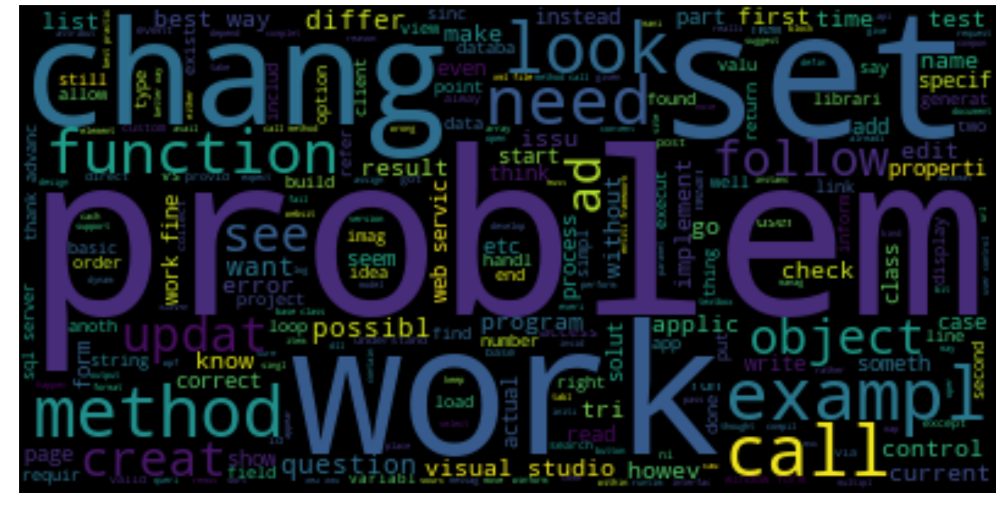

In [146]:


from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_csharpefinal1),stopwords=stopwords)
wc.generate(df_csharpefinal1)
print ("Word Cloud for c#")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the c# tag.

# Word Cloud for java:

Word Cloud for java


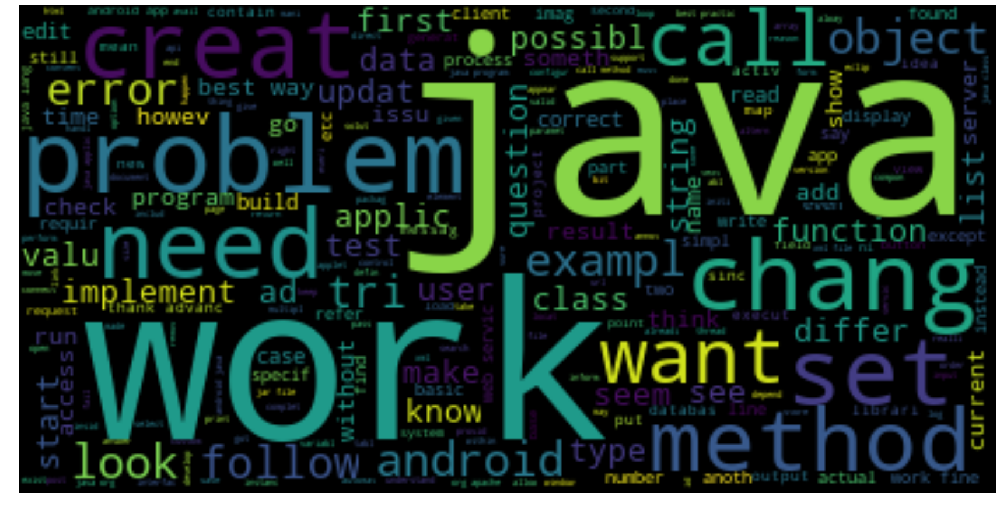

In [147]:


from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_javafinal1),stopwords = stopwords)
wc.generate(df_javafinal1)
print ("Word Cloud for java")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the java tag.



# Word Cloud for php:

Word Cloud for php


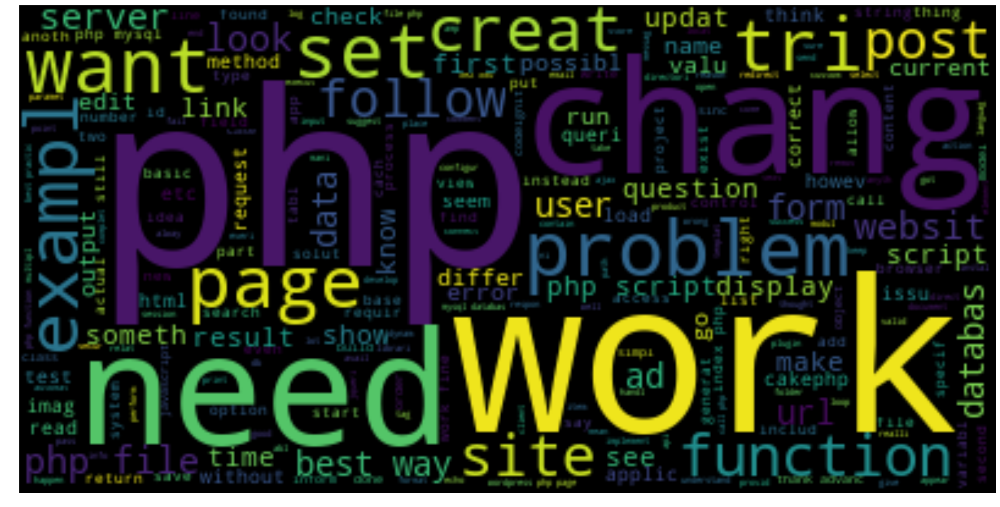

In [148]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_phpfinal1),stopwords = stopwords)
wc.generate(df_phpfinal1)
print ("Word Cloud for php")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the php tag.




# Word Cloud for javascript:


Word Cloud for javascript


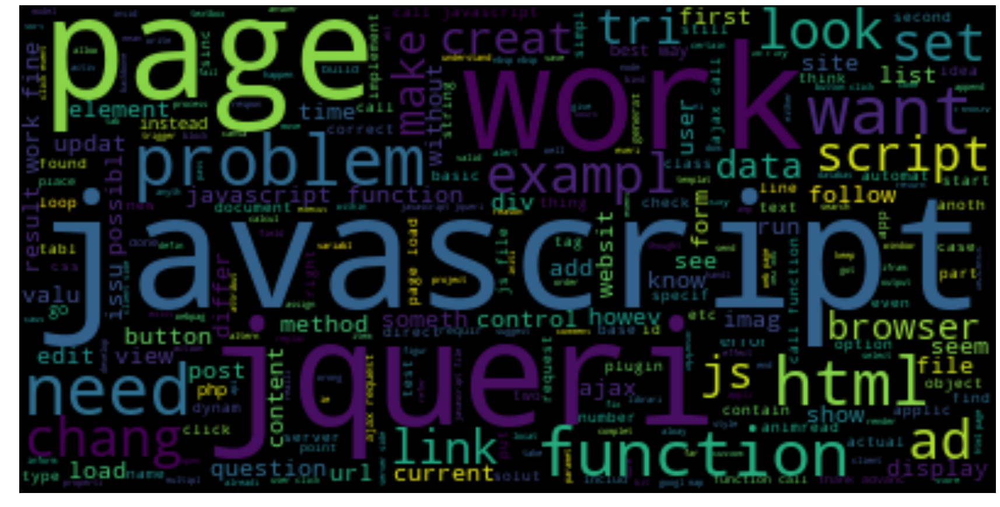

In [149]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_javascriptfinal1),stopwords = stopwords)
wc.generate(df_javascriptfinal1)
print ("Word Cloud for javascript")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the javascript tag.




# Word Cloud for android:


Word Cloud for android


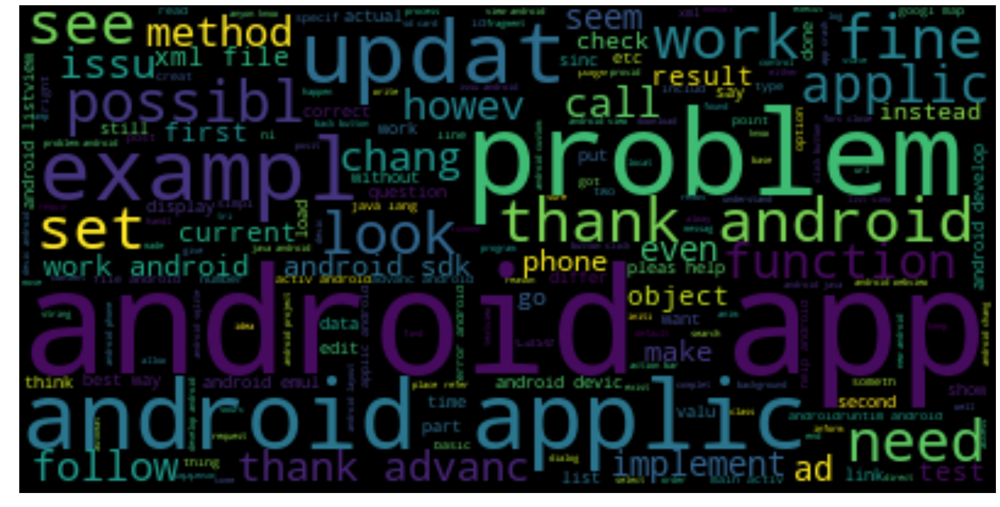

In [150]:

from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_androidfinal1),stopwords = stopwords)
wc.generate(df_androidfinal1)
print ("Word Cloud for android")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the android tag.

# Word Cloud for jquery:


Word Cloud for jquery


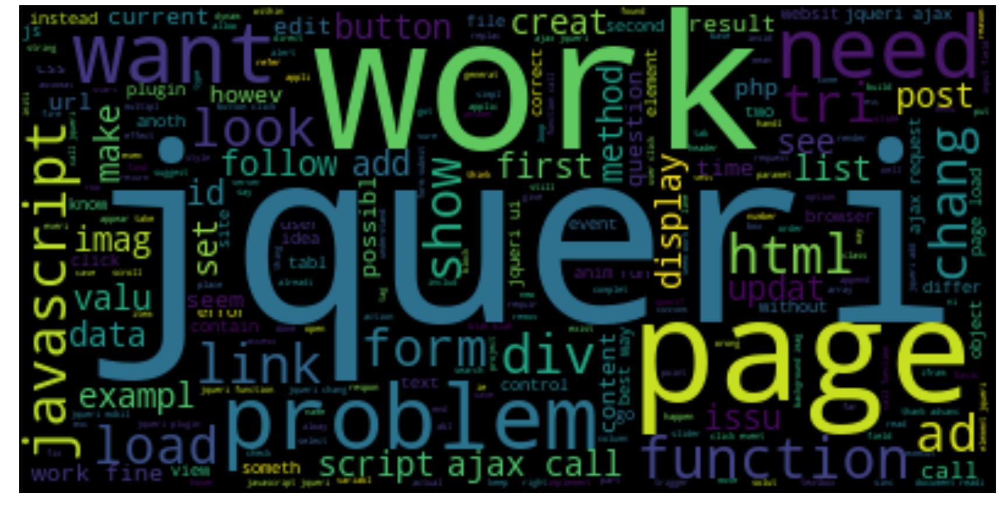

In [151]:


from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_jqueryfinal1),stopwords = stopwords)
wc.generate(df_jqueryfinal1)
print ("Word Cloud for jquery")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the jquery tag.

# Word Cloud for cplusplus:


Word Cloud for C++


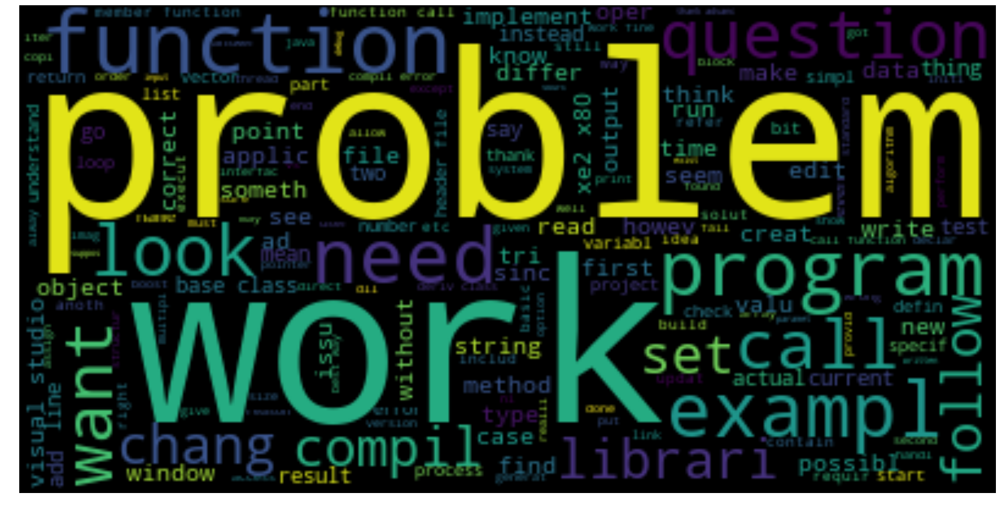

In [152]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_cplusplusfinal1),stopwords = stopwords)
wc.generate(df_cplusplusfinal1)
print ("Word Cloud for C++")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the c++ tag.




# Word Cloud for python:


Word Cloud for Python


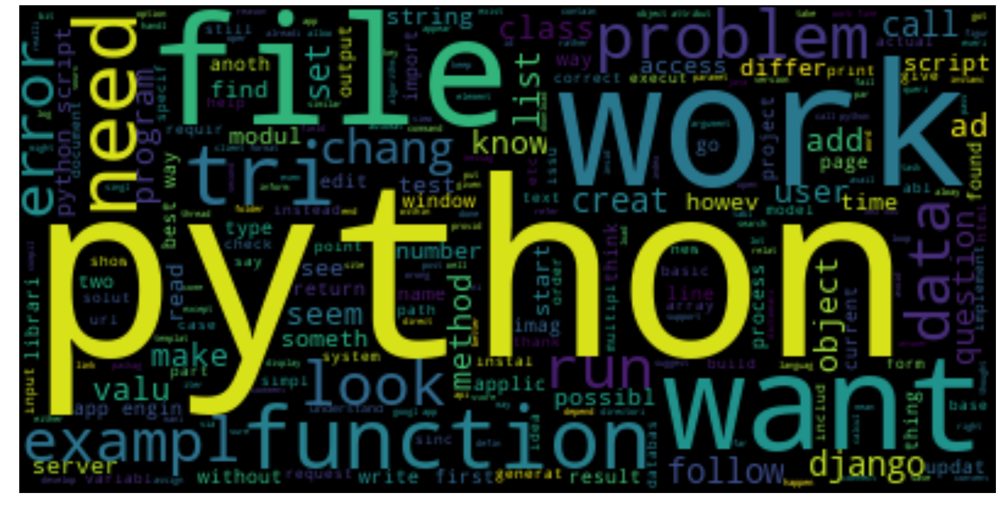

In [153]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_pythonfinal1),stopwords = stopwords)
wc.generate(df_pythonfinal1)
print ("Word Cloud for Python")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the python tag.




# Word Cloud for iphone:


Word Cloud for iphone


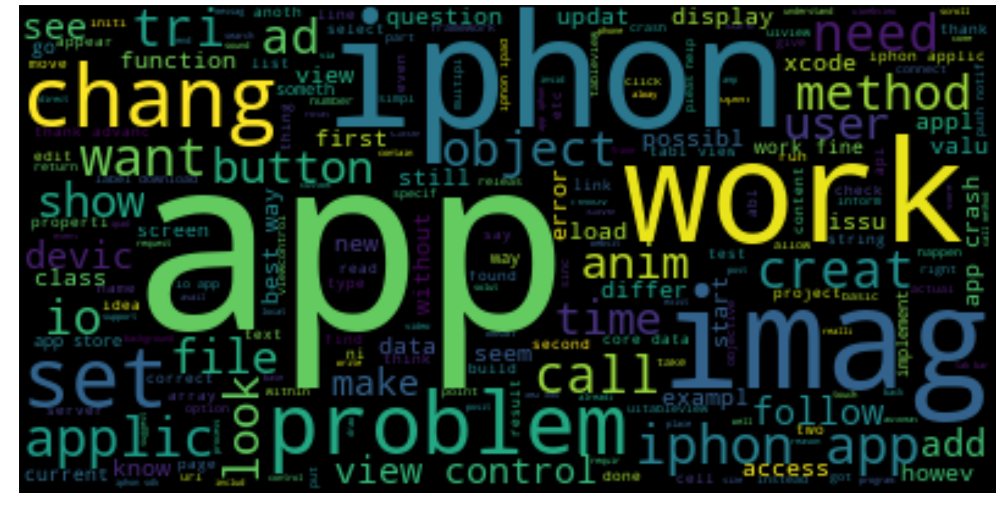

In [154]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_iphonefinal1),stopwords = stopwords)
wc.generate(df_iphonefinal1)
print ("Word Cloud for iphone")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the iphone tag.




# Word Cloud for aspnet:


Word Cloud for asp.net


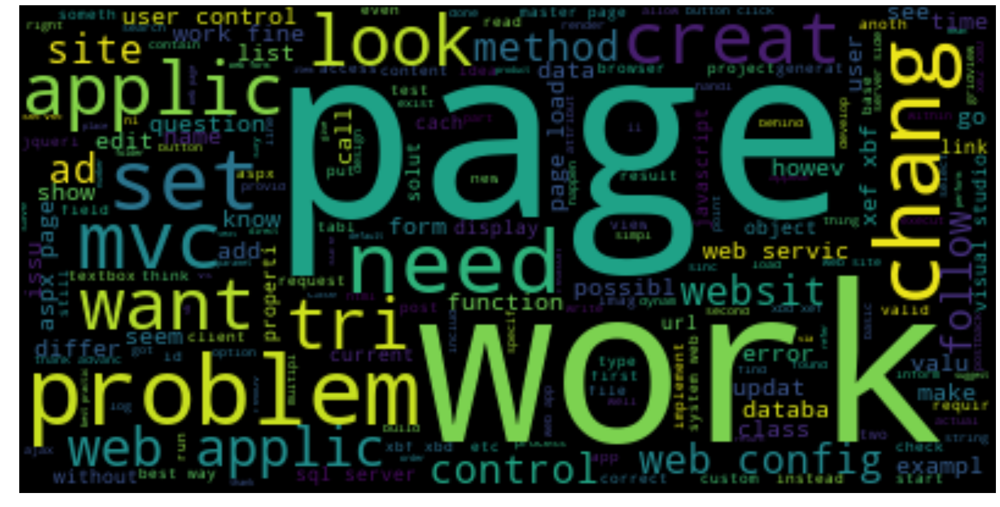

In [155]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_aspnetfinal1),stopwords = stopwords)
wc.generate(df_aspnetfinal1)
print ("Word Cloud for asp.net")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the asp.net tag.




# Word Cloud for mysql:


Word Cloud for mysql


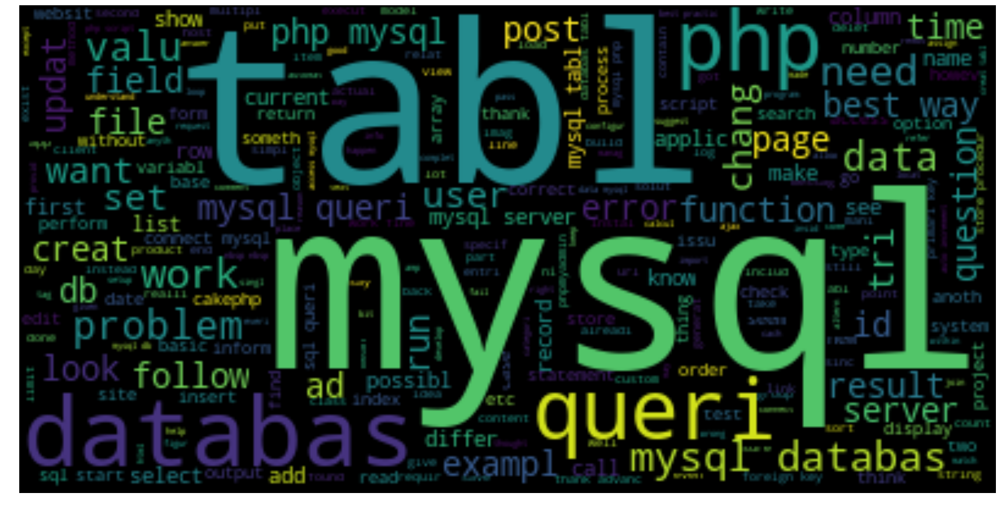

In [156]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_mysqlfinal1),stopwords = stopwords)
wc.generate(df_mysqlfinal1)
print ("Word Cloud for mysql")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the mysql tag.




# Word Cloud for html:


Word Cloud for html


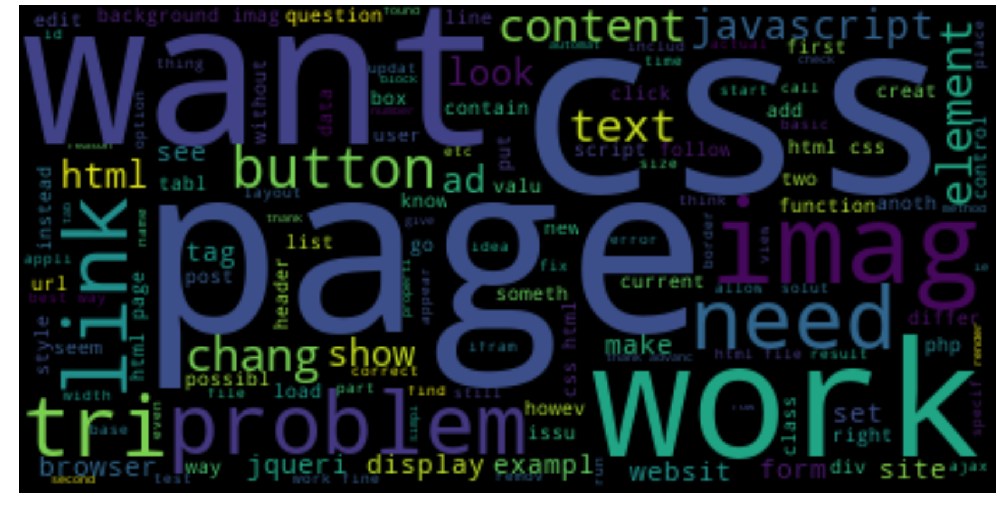

In [157]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_htmlfinal1),stopwords = stopwords)
wc.generate(df_htmlfinal1)
print ("Word Cloud for html")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the html tag.




# Word Cloud for dotnet:


Word Cloud for dotnet


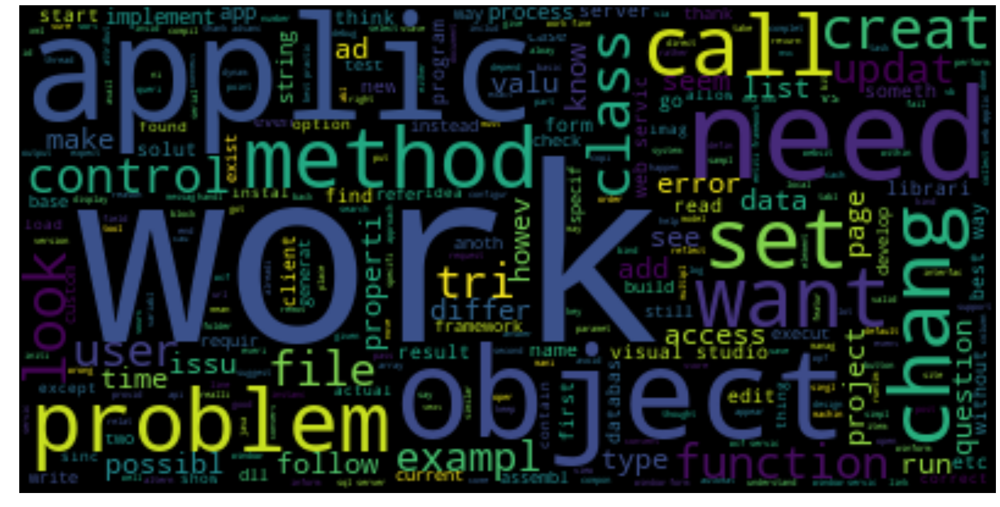

In [158]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_dotnetfinal1),stopwords = stopwords)
wc.generate(df_dotnetfinal1)
print ("Word Cloud for dotnet")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the .net tag.




# Word Cloud for ios:


Word Cloud for ios


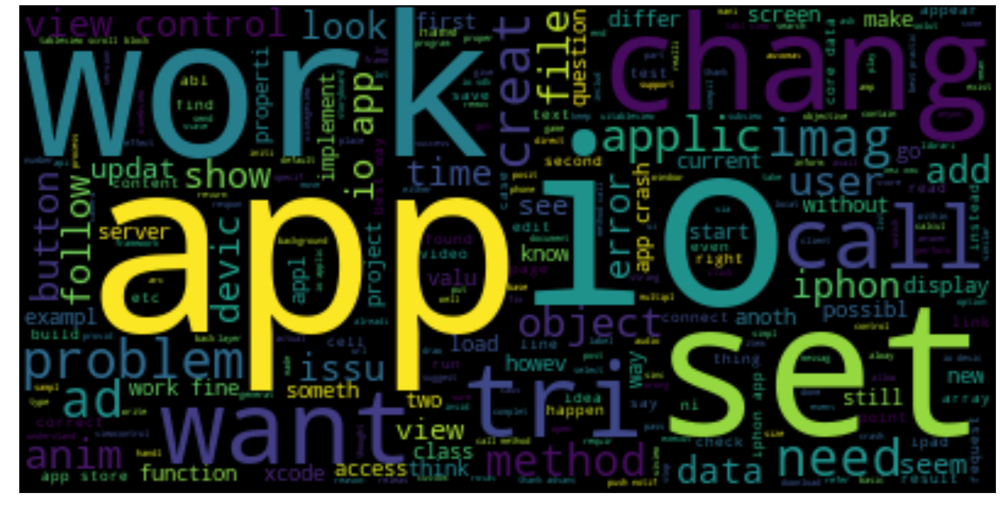

In [159]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_iosfinal1),stopwords = stopwords)
wc.generate(df_iosfinal1)
print ("Word Cloud for ios")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the ios tag.




# Word Cloud for objectivec:


Word Cloud for Objective-C


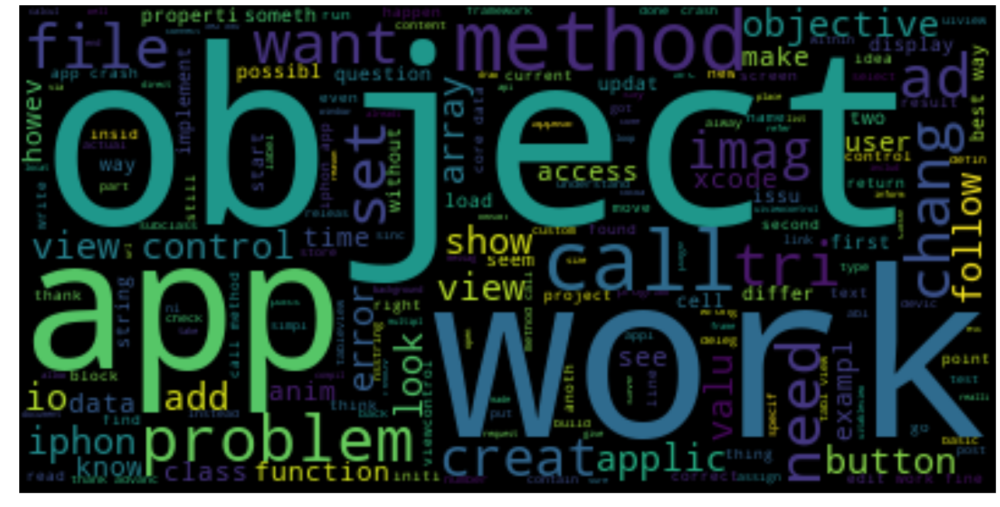

In [160]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_objectivec1),stopwords = stopwords)
wc.generate(df_objectivec1)
print ("Word Cloud for Objective-C")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the objective-c tag.




# Word Cloud for sql:


Word Cloud for SQL


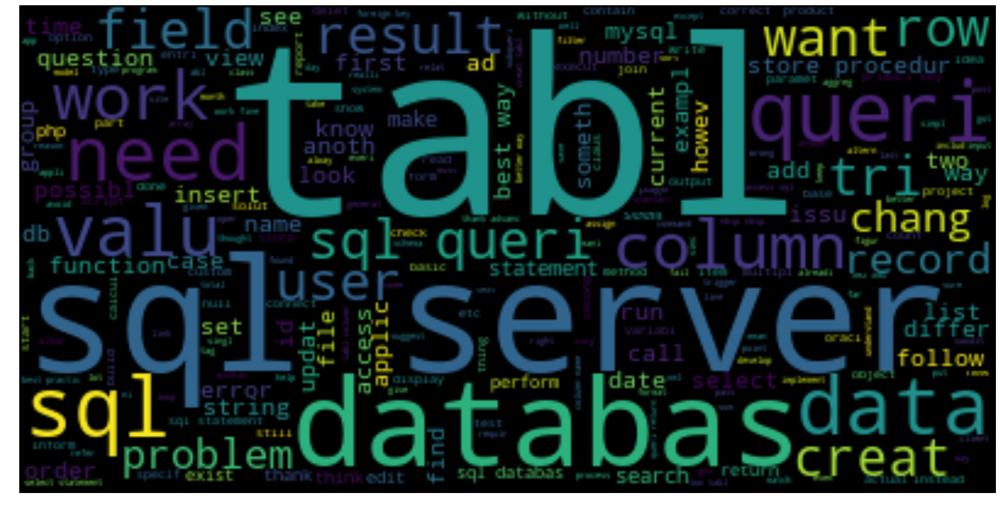

In [161]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_sqlfinal1),stopwords = stopwords)
wc.generate(df_sqlfinal1)
print ("Word Cloud for SQL")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the sql tag.

# Word Cloud for css:


Word Cloud for CSS


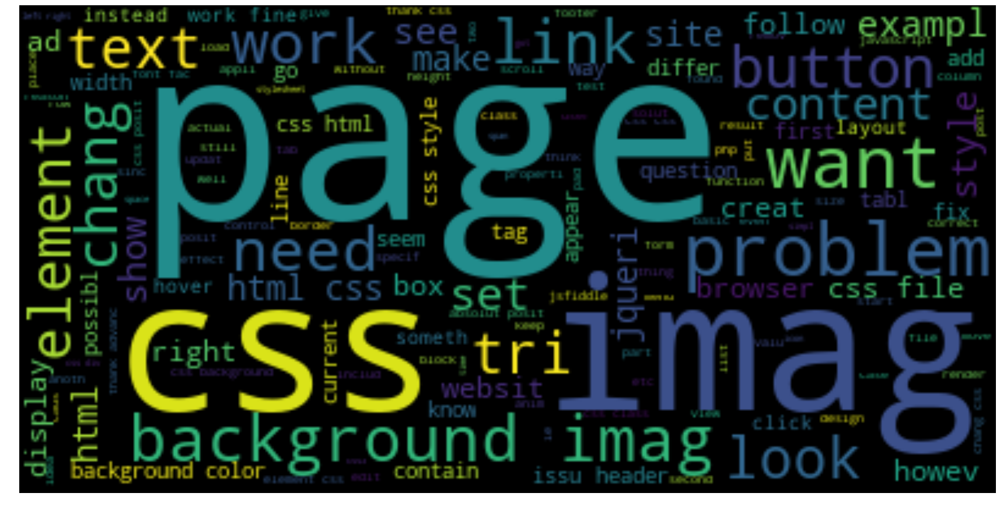

In [162]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_cssfinal1),stopwords = stopwords)
wc.generate(df_cssfinal1)
print ("Word Cloud for CSS")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the css tag.

# Word Cloud for rubyonrails:


Word Cloud for Ruby On Rails


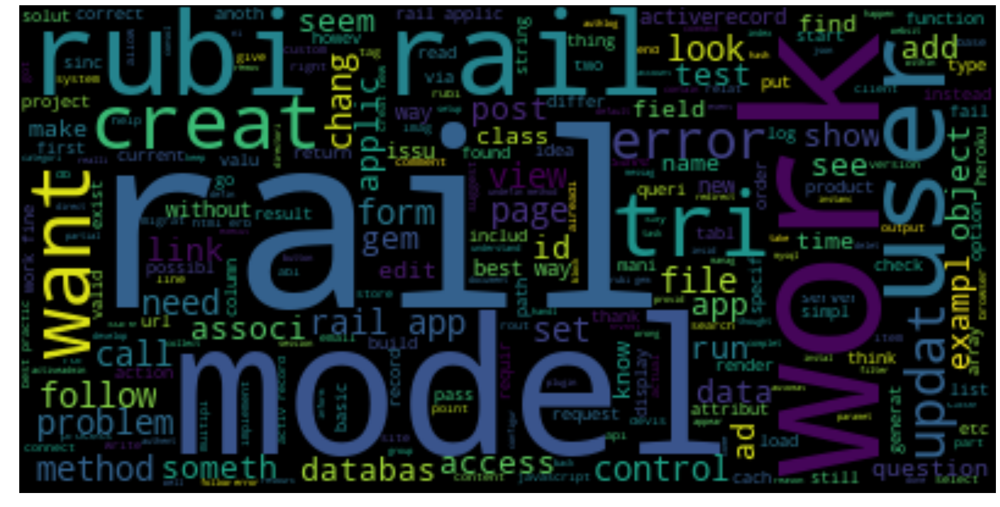

In [163]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_rubyonrails1),stopwords = stopwords)
wc.generate(df_rubyonrails1)
print ("Word Cloud for Ruby On Rails")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the ruby on rails tag.

# Word Cloud for linux:


Word Cloud for Linux


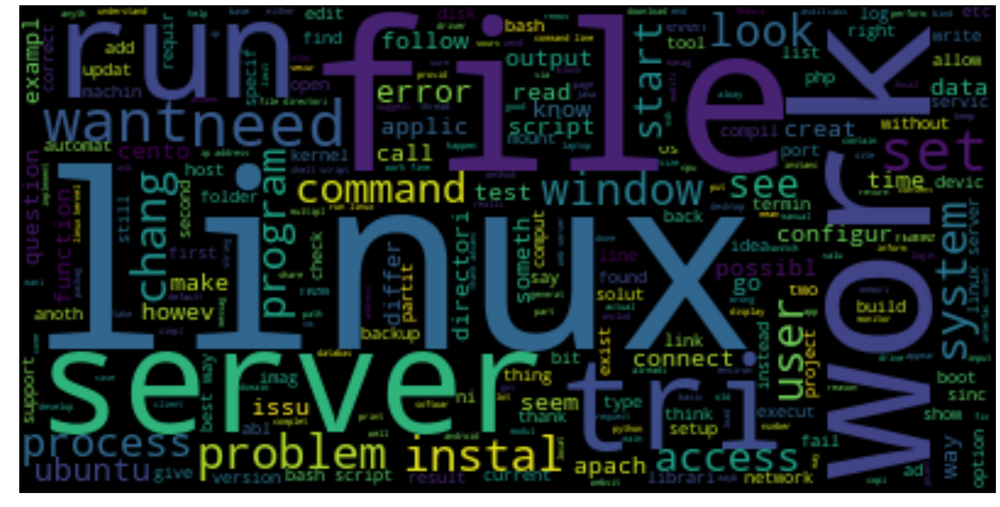

In [164]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_linuxfinal1),stopwords = stopwords)
wc.generate(df_linuxfinal1)
print ("Word Cloud for Linux")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the linux tag.

# Word Cloud for c:

Word Cloud C


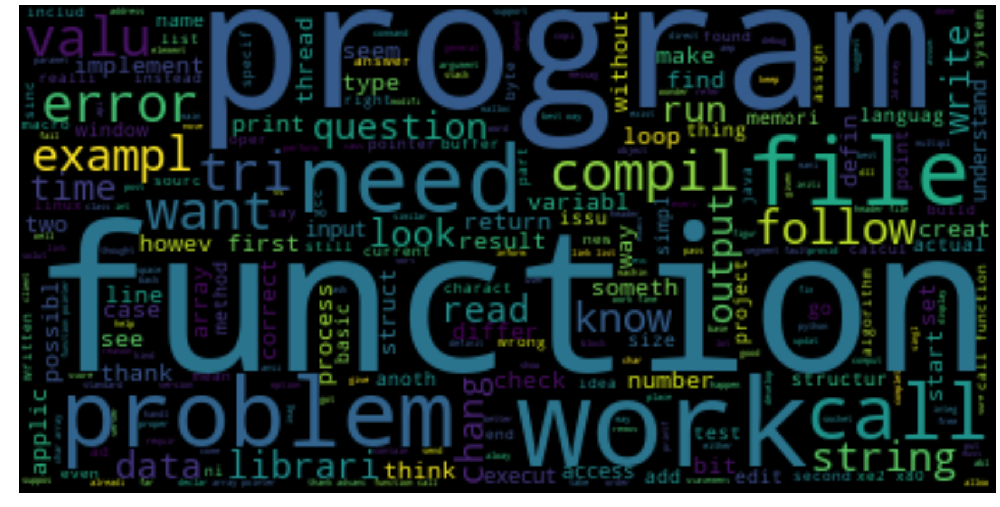

In [165]:
from wordcloud import WordCloud, STOPWORDS

plt.figure(figsize=(30,20))
wc = WordCloud(background_color="black",max_font_size=100, max_words=len(df_cfinal1),stopwords = stopwords)
wc.generate(df_cfinal1)
print ("Word Cloud C")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# The word cloud shows the words used in questions for the c tag.

In [51]:
print("number of data points in sample :", preprocessed_data.shape[0])
print("number of dimensions :", preprocessed_data.shape[1])

number of data points in sample : 500000
number of dimensions : 2


In [52]:
# Converting stringtags to multilabel output variables

vectorizer = CountVectorizer(tokenizer = lambda x: x.split(), binary='true')
multilabel_y = vectorizer.fit_transform(preprocessed_data['tags'])

In [53]:
# Selecting 500 tags

questions_explained = []
total_tags=multilabel_y.shape[1]
total_qs=preprocessed_data.shape[0]
for i in range(500, total_tags, 100):
    questions_explained.append(np.round(((total_qs-questions_explained_fn(i))/total_qs)*100,3))

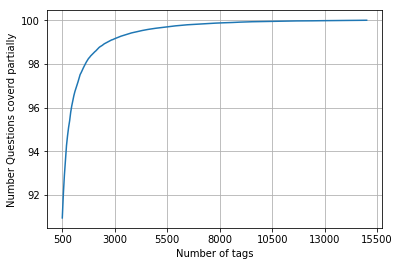

with  500 tags we are covering  90.956 % of questions


In [54]:
fig, ax = plt.subplots()
ax.plot(questions_explained)
xlabel = list(500+np.array(range(-50,450,50))*50)
ax.set_xticklabels(xlabel)
plt.xlabel("Number of tags")
plt.ylabel("Number Questions coverd partially")
plt.grid()
plt.show()
# you can choose any number of tags based on your computing power, minimun is 500(it covers 90% of the tags)
#print("with ",5500,"tags we are covering ",questions_explained[50],"% of questions")
print("with ",500,"tags we are covering ",questions_explained[0],"% of questions")

In [55]:
# we will be taking 500 tags
multilabel_yx = tags_to_choose(500)
print("number of questions that are not covered :", questions_explained_fn(500),"out of ", total_qs)

number of questions that are not covered : 45221 out of  500000


In [56]:
x_train=preprocessed_data.head(train_datasize)
x_test=preprocessed_data.tail(preprocessed_data.shape[0] - 400000)

y_train = multilabel_yx[0:train_datasize,:]
y_test = multilabel_yx[train_datasize:preprocessed_data.shape[0],:]

In [57]:
print("Number of data points in train data :", y_train.shape)
print("Number of data points in test data :", y_test.shape)

Number of data points in train data : (400000, 500)
Number of data points in test data : (100000, 500)


# Machine Learning Models:

<h3> Featurizing data with TfIdf vectorizer </h3>

In [60]:
start = datetime.now()
vectorizer = TfidfVectorizer(min_df=0.00009, max_features=100000, smooth_idf=True, norm="l2", \
                             tokenizer = lambda x: x.split(), sublinear_tf=False, ngram_range=(1,3))
x_train_multilabel = vectorizer.fit_transform(x_train['question'])
x_test_multilabel = vectorizer.transform(x_test['question'])
print("Time taken to run this cell :", datetime.now() - start)

Time taken to run this cell : 0:09:49.249701


In [59]:
print("Dimensions of train data X:",x_train_multilabel.shape, "Y :",y_train.shape)
print("Dimensions of test data X:",x_test_multilabel.shape,"Y:",y_test.shape)

Dimensions of train data X: (400000, 94927) Y : (400000, 500)
Dimensions of test data X: (100000, 94927) Y: (100000, 500)


<h3> Applying Logistic Regression with OneVsRest Classifier </h3>

In [60]:
start = datetime.now()
classifier = OneVsRestClassifier(SGDClassifier(loss='log', alpha=0.00001, penalty='l1'), n_jobs=-1)
classifier.fit(x_train_multilabel, y_train)
predictions = classifier.predict (x_test_multilabel)


print("Accuracy :",metrics.accuracy_score(y_test, predictions))
print("Hamming loss ",metrics.hamming_loss(y_test,predictions))


precision = precision_score(y_test, predictions, average='micro')
recall = recall_score(y_test, predictions, average='micro')
f1 = f1_score(y_test, predictions, average='micro')
 
print("Micro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

precision = precision_score(y_test, predictions, average='macro')
recall = recall_score(y_test, predictions, average='macro')
f1 = f1_score(y_test, predictions, average='macro')
 
print("Macro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

print (metrics.classification_report(y_test, predictions))
print("Time taken to run this cell :", datetime.now() - start)

Accuracy : 0.23574
Hamming loss  0.0027836
Micro-average quality numbers
Precision: 0.7214, Recall: 0.3246, F1-measure: 0.4478
Macro-average quality numbers
Precision: 0.5509, Recall: 0.2564, F1-measure: 0.3333
             precision    recall  f1-score   support

          0       0.95      0.64      0.76      5519
          1       0.69      0.26      0.38      8190
          2       0.81      0.37      0.51      6529
          3       0.81      0.42      0.56      3231
          4       0.81      0.41      0.54      6430
          5       0.82      0.34      0.48      2879
          6       0.87      0.49      0.63      5086
          7       0.87      0.54      0.67      4533
          8       0.61      0.13      0.22      3000
          9       0.81      0.52      0.63      2765
         10       0.60      0.16      0.25      3051
         11       0.69      0.33      0.45      3009
         12       0.65      0.25      0.36      2630
         13       0.71      0.23      0.35    

<h3> Applying Linear SVM with OneVsRest Classifier </h3>

In [61]:
start = datetime.now()
classifier = OneVsRestClassifier(SGDClassifier(loss='hinge', alpha=0.00001, penalty='l1'), n_jobs=-1)
classifier.fit(x_train_multilabel, y_train)
predictions = classifier.predict (x_test_multilabel)


print("Accuracy :",metrics.accuracy_score(y_test, predictions))
print("Hamming loss ",metrics.hamming_loss(y_test,predictions))


precision = precision_score(y_test, predictions, average='micro')
recall = recall_score(y_test, predictions, average='micro')
f1 = f1_score(y_test, predictions, average='micro')
 
print("Micro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

precision = precision_score(y_test, predictions, average='macro')
recall = recall_score(y_test, predictions, average='macro')
f1 = f1_score(y_test, predictions, average='macro')
 
print("Macro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

print (metrics.classification_report(y_test, predictions))
print("Time taken to run this cell :", datetime.now() - start)

Accuracy : 0.24829
Hamming loss  0.00269458
Micro-average quality numbers
Precision: 0.8074, Recall: 0.2953, F1-measure: 0.4324
Macro-average quality numbers
Precision: 0.4173, Recall: 0.2180, F1-measure: 0.2646
             precision    recall  f1-score   support

          0       0.95      0.68      0.79      5519
          1       0.70      0.22      0.33      8190
          2       0.84      0.36      0.50      6529
          3       0.82      0.41      0.55      3231
          4       0.85      0.37      0.52      6430
          5       0.82      0.36      0.50      2879
          6       0.88      0.51      0.65      5086
          7       0.89      0.55      0.68      4533
          8       0.61      0.15      0.24      3000
          9       0.83      0.52      0.64      2765
         10       0.57      0.01      0.02      3051
         11       0.77      0.32      0.45      3009
         12       0.74      0.22      0.34      2630
         13       0.72      0.18      0.29   

<h1> 5. Assignments </h1>

<ol>
    <li> Use bag of words upto 4 grams and compute the micro f1 score with Logistic regression(OvR) </li>
    <li> Perform hyperparam tuning on alpha (or lambda) for Logistic regression to improve the performance using GridSearch  </li>
    <li> Try OneVsRestClassifier  with Linear-SVM (SGDClassifier with loss-hinge)</li>
</ol>

# We will vectorize our data using the BoW features.

In [75]:
# Creating our countvectorizer with words upto 4 grams
start_time = datetime.now()

count_vectorizer = CountVectorizer(min_df= 0.00009, max_features= 100000, tokenizer= lambda x: x.split(),
                                  ngram_range= (1,3))

x_train_countvect = count_vectorizer.fit_transform(x_train['question']) # fit our countvectorizer to the train data and transform it
x_test_countvect = count_vectorizer.transform(x_test['question']) # transform our test data using the countvectorizer

print('Time taken to run the cell :', datetime.now()-start_time)


KeyboardInterrupt: 

## Performing hyperparameter tuning for Logistic Regression using gridsearch for improvement in model performance for TF-IDF features:

In [76]:
from sklearn.model_selection import GridSearchCV

# Declaring the parameter grid:
params= {'estimator__alpha': [10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]}

# Declaring our classifier
logistic_classifier = OneVsRestClassifier(SGDClassifier(loss = 'log', penalty = 'l2'))

# Applying gridsearch to our algorithm to get the best parameters:

gs_logit = GridSearchCV(estimator = logistic_classifier, param_grid = params, cv = 3, verbose = 0, scoring = 'f1_micro')

gs_logit.fit(x_train_multilabel, y_train)


GridSearchCV(cv=3, error_score='raise',
       estimator=OneVsRestClassifier(estimator=SGDClassifier(alpha=0.0001, average=False, class_weight=None, epsilon=0.1,
       eta0=0.0, fit_intercept=True, l1_ratio=0.15,
       learning_rate='optimal', loss='log', max_iter=None, n_iter=None,
       n_jobs=1, penalty='l2', power_t=0.5, random_state=None,
       shuffle=True, tol=None, verbose=0, warm_start=False),
          n_jobs=1),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'estimator__alpha': [1e-05, 0.0001, 0.001, 0.01, 0.1, 1, 10]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='f1_micro', verbose=0)

In [77]:
# Extracting the best parameters of our model:

print('The best parameters for our model are: ')

gs_logit.best_params_

The best parameters for our model are: 


{'estimator__alpha': 1e-05}

In [78]:
# Creating our final model using the best parameters:

start = datetime.now()
log_clf_final = OneVsRestClassifier(SGDClassifier(loss='log', alpha= 0.00001, penalty='l2'), n_jobs=-1)
log_clf_final.fit(x_train_multilabel, y_train)
predictions = log_clf_final.predict (x_test_multilabel)


print("Accuracy :",metrics.accuracy_score(y_test, predictions))
print("Hamming loss ",metrics.hamming_loss(y_test,predictions))


precision = precision_score(y_test, predictions, average='micro')
recall = recall_score(y_test, predictions, average='micro')
f1 = f1_score(y_test, predictions, average='micro')
 
print("Micro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

precision = precision_score(y_test, predictions, average='macro')
recall = recall_score(y_test, predictions, average='macro')
f1 = f1_score(y_test, predictions, average='macro')
 
print("Macro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

print (metrics.classification_report(y_test, predictions))
print("Time taken to run this cell :", datetime.now() - start)

Accuracy : 0.20908
Hamming loss  0.00290586
Micro-average quality numbers
Precision: 0.7783, Recall: 0.2294, F1-measure: 0.3544
Macro-average quality numbers
Precision: 0.5523, Recall: 0.1268, F1-measure: 0.1907
             precision    recall  f1-score   support

          0       0.96      0.60      0.73      5519
          1       0.70      0.25      0.36      8190
          2       0.83      0.32      0.46      6529
          3       0.83      0.37      0.52      3231
          4       0.84      0.36      0.51      6430
          5       0.83      0.31      0.45      2879
          6       0.90      0.44      0.60      5086
          7       0.89      0.50      0.64      4533
          8       0.61      0.12      0.20      3000
          9       0.84      0.50      0.63      2765
         10       0.63      0.14      0.22      3051
         11       0.75      0.27      0.40      3009
         12       0.68      0.19      0.29      2630
         13       0.77      0.17      0.28   

## Performing hyperparameter tuning for Logistic Regression using gridsearch for improvement in model performance for BoW features:

In [65]:
from sklearn.model_selection import GridSearchCV

# Declaring the parameter grid:
params= {'estimator__alpha': [10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]}

# Declaring our classifier
logistic_classifier_bow = OneVsRestClassifier(SGDClassifier(loss = 'log', penalty = 'l2'))

# Applying gridsearch to our algorithm to get the best parameters:

gs_logit_bow = GridSearchCV(estimator = logistic_classifier_bow, param_grid = params, cv = 3, verbose = 0, scoring = 'f1_micro')

gs_logit_bow.fit(x_train_countvect, y_train)

GridSearchCV(cv=3, error_score='raise',
       estimator=OneVsRestClassifier(estimator=SGDClassifier(alpha=0.0001, average=False, class_weight=None, epsilon=0.1,
       eta0=0.0, fit_intercept=True, l1_ratio=0.15,
       learning_rate='optimal', loss='log', max_iter=None, n_iter=None,
       n_jobs=1, penalty='l2', power_t=0.5, random_state=None,
       shuffle=True, tol=None, verbose=0, warm_start=False),
          n_jobs=1),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'estimator__alpha': [1e-05, 0.0001, 0.001, 0.01, 0.1, 1, 10]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='f1_micro', verbose=0)

In [67]:
# Extracting the best parameters of our model:

print('The best parameters for our model are: ')

gs_logit_bow.best_params_

The best parameters for our model are: 


{'estimator__alpha': 0.0001}

In [68]:
# Creating our final model using the best parameters:

start = datetime.now()
log_clf_final_bow = OneVsRestClassifier(SGDClassifier(loss='log', alpha= 0.0001, penalty='l2'), n_jobs=-1)
log_clf_final_bow.fit(x_train_countvect, y_train)
predictions = log_clf_final_bow.predict (x_test_countvect)


print("Accuracy :",metrics.accuracy_score(y_test, predictions))
print("Hamming loss ",metrics.hamming_loss(y_test,predictions))


precision = precision_score(y_test, predictions, average='micro')
recall = recall_score(y_test, predictions, average='micro')
f1 = f1_score(y_test, predictions, average='micro')
 
print("Micro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

precision = precision_score(y_test, predictions, average='macro')
recall = recall_score(y_test, predictions, average='macro')
f1 = f1_score(y_test, predictions, average='macro')
 
print("Macro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

print (metrics.classification_report(y_test, predictions))
print("Time taken to run this cell :", datetime.now() - start)

Accuracy : 0.22871
Hamming loss  0.00289452
Micro-average quality numbers
Precision: 0.6474, Recall: 0.3675, F1-measure: 0.4688
Macro-average quality numbers
Precision: 0.5111, Recall: 0.3181, F1-measure: 0.3821
             precision    recall  f1-score   support

          0       0.94      0.66      0.78      5519
          1       0.61      0.29      0.39      8190
          2       0.80      0.35      0.49      6529
          3       0.79      0.43      0.55      3231
          4       0.75      0.44      0.56      6430
          5       0.75      0.37      0.49      2879
          6       0.82      0.53      0.64      5086
          7       0.87      0.54      0.66      4533
          8       0.49      0.16      0.25      3000
          9       0.81      0.54      0.65      2765
         10       0.52      0.24      0.33      3051
         11       0.70      0.36      0.47      3009
         12       0.62      0.26      0.37      2630
         13       0.72      0.24      0.36   

## Performing hyperparameter tuning for Linear SVM using gridsearch for improvement in model performance for BoW features:

In [72]:
# Declaring the parameter grid:
params= {'estimator__alpha': [10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]}

# Declaring our classifier
lrsvm_classifier_bow = OneVsRestClassifier(SGDClassifier(loss = 'hinge', penalty = 'l2'))

# Applying gridsearch to our algorithm to get the best parameters:

gs_lrsvm_bow = GridSearchCV(estimator = lrsvm_classifier_bow, param_grid = params, cv = 3, verbose = 0, scoring = 'f1_micro')

gs_lrsvm_bow.fit(x_train_countvect, y_train)

GridSearchCV(cv=3, error_score='raise',
       estimator=OneVsRestClassifier(estimator=SGDClassifier(alpha=0.0001, average=False, class_weight=None, epsilon=0.1,
       eta0=0.0, fit_intercept=True, l1_ratio=0.15,
       learning_rate='optimal', loss='hinge', max_iter=None, n_iter=None,
       n_jobs=1, penalty='l2', power_t=0.5, random_state=None,
       shuffle=True, tol=None, verbose=0, warm_start=False),
          n_jobs=1),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'estimator__alpha': [1e-05, 0.0001, 0.001, 0.01, 0.1, 1, 10]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='f1_micro', verbose=0)

In [73]:
# Extracting the best parameters of our model:

print('The best parameters for our model are: ')

gs_lrsvm_bow.best_params_

The best parameters for our model are: 


{'estimator__alpha': 0.0001}

In [74]:
# Creating our final model using the best parameters:

start = datetime.now()
lrsvm_clf_final_bow = OneVsRestClassifier(SGDClassifier(loss='log', alpha= 0.0001, penalty='l2'), n_jobs=-1)
lrsvm_clf_final_bow.fit(x_train_countvect, y_train)
predictions = lrsvm_clf_final_bow.predict (x_test_countvect)


print("Accuracy :",metrics.accuracy_score(y_test, predictions))
print("Hamming loss ",metrics.hamming_loss(y_test,predictions))


precision = precision_score(y_test, predictions, average='micro')
recall = recall_score(y_test, predictions, average='micro')
f1 = f1_score(y_test, predictions, average='micro')
 
print("Micro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

precision = precision_score(y_test, predictions, average='macro')
recall = recall_score(y_test, predictions, average='macro')
f1 = f1_score(y_test, predictions, average='macro')
 
print("Macro-average quality numbers")
print("Precision: {:.4f}, Recall: {:.4f}, F1-measure: {:.4f}".format(precision, recall, f1))

print (metrics.classification_report(y_test, predictions))
print("Time taken to run this cell :", datetime.now() - start)

Accuracy : 0.22981
Hamming loss  0.00288034
Micro-average quality numbers
Precision: 0.6517, Recall: 0.3681, F1-measure: 0.4705
Macro-average quality numbers
Precision: 0.5155, Recall: 0.3205, F1-measure: 0.3836
             precision    recall  f1-score   support

          0       0.93      0.69      0.79      5519
          1       0.63      0.27      0.38      8190
          2       0.78      0.37      0.50      6529
          3       0.78      0.46      0.58      3231
          4       0.73      0.45      0.56      6430
          5       0.77      0.34      0.47      2879
          6       0.87      0.48      0.62      5086
          7       0.85      0.56      0.68      4533
          8       0.45      0.14      0.22      3000
          9       0.80      0.54      0.64      2765
         10       0.59      0.15      0.24      3051
         11       0.67      0.39      0.50      3009
         12       0.59      0.29      0.39      2630
         13       0.71      0.28      0.40   

# Conclusion/ model performance:

In [167]:
import prettytable
from prettytable import PrettyTable

list1 = ['Linear SVM','Logistic Regression w/ gridsearch','Logistic Regression w/ gridsearch','Linear SVM w/ gridsearch']
list2 = ['TF-IDF','TF-IDF','BoW','BoW']
list3 = ['0.4324','0.3544','0.4688','0.4705']
list4 = ['0.2646','0.1907','0.3821','0.3836']
list5 = ['0.0026','0.0029','0.0028','0.0028']


print('The scores for the different models are:')
table = PrettyTable(['Model','Vector Rep','Micro F1 score', 'Macro F1 score', 'Hamming Loss'])
for x in range(0,4):
    table.add_row([list1[x],list2[x],list3[x],list4[x], list5[x]])
                                       
print(table)  

The scores for the different models are:
+-----------------------------------+------------+----------------+----------------+--------------+
|               Model               | Vector Rep | Micro F1 score | Macro F1 score | Hamming Loss |
+-----------------------------------+------------+----------------+----------------+--------------+
|             Linear SVM            |   TF-IDF   |     0.4324     |     0.2646     |    0.0026    |
| Logistic Regression w/ gridsearch |   TF-IDF   |     0.3544     |     0.1907     |    0.0029    |
| Logistic Regression w/ gridsearch |    BoW     |     0.4688     |     0.3821     |    0.0028    |
|      Linear SVM w/ gridsearch     |    BoW     |     0.4705     |     0.3836     |    0.0028    |
+-----------------------------------+------------+----------------+----------------+--------------+


# Project Summary: